In [ ]:
!wget https://s3.amazonaws.com/tripdata/JC-202407-citibike-tripdata.csv.zip

--2024-09-12 09:50:38--  https://s3.amazonaws.com/tripdata/JC-202407-citibike-tripdata.csv.zip
Resolving s3.amazonaws.com (s3.amazonaws.com)... 52.217.88.182, 16.15.176.109, 52.217.232.80, ...
Connecting to s3.amazonaws.com (s3.amazonaws.com)|52.217.88.182|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 4198201 (4.0M) [application/zip]
Saving to: ‘JC-202407-citibike-tripdata.csv.zip’

JC-202407-citibike- 100%[===================>]   4.00M  20.0MB/s    in 0.2s    

2024-09-12 09:50:38 (20.0 MB/s) - ‘JC-202407-citibike-tripdata.csv.zip’ saved [4198201/4198201]



In [ ]:
!unzip JC-202407-citibike-tripdata.csv.zip

Archive:  JC-202407-citibike-tripdata.csv.zip
  inflating: JC-202407-citibike-tripdata.csv  
  inflating: __MACOSX/._JC-202407-citibike-tripdata.csv  


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from datetime import datetime

df = pd.read_csv('/content/JC-202407-citibike-tripdata.csv')
df

,ride_id,rideable_type,started_at,ended_at,start_station_name,start_station_id,end_station_name,end_station_id,start_lat,start_lng,end_lat,end_lng,member_casual
0,6B61E4880B1DE1E9,electric_bike,2024-07-31 12:06:49.628,2024-07-31 12:23:59.876,14 St Ferry - 14 St & Shipyard Ln,HB202,Brunswick & 6th,JC081,40.752961,-74.024353,40.726012,-74.050389,member
1,B593705A700E04B9,electric_bike,2024-07-01 07:53:20.019,2024-07-01 08:13:56.570,Leonard Gordon Park,JC080,McGinley Square,JC055,40.745717,-74.057247,40.725340,-74.067622,member
2,19CFBBAF90BF45B8,electric_bike,2024-07-30 14:57:29.219,2024-07-30 15:10:49.553,Liberty Light Rail,JC052,Hoboken Ave at Monmouth St,JC105,40.711242,-74.055701,40.735208,-74.046964,casual
3,8E6563C41AA8A1B4,electric_bike,2024-07-17 17:02:20.147,2024-07-17 17:04:50.818,Grand St & 14 St,HB506,Madison St & 10 St,HB503,40.754090,-74.031600,40.749943,-74.035865,member
4,44065C7E4AE573FA,electric_bike,2024-07-20 17:19:44.970,2024-07-20 17:39:09.894,Hoboken Terminal - River St & Hudson Pl,HB102,Madison St & 10 St,HB503,40.736068,-74.029127,40.749943,-74.035865,casual
...,...,...,...,...,...,...,...,...,...,...,...,...,...
112438,CAD6D7EFE3F58AA6,electric_bike,2024-07-27 21:26:25.910,2024-07-27 21:28:57.142,6 St & Grand St,HB302,Clinton St & Newark St,HB409,40.744398,-74.034501,40.737430,-74.035710,casual
112439,275AD3C5108A626F,electric_bike,2024-07-04 23:58:34.303,2024-07-05 00:04:09.775,6 St & Grand St,HB302,Clinton St & Newark St,HB409,40.744306,-74.034364,40.737430,-74.035710,casual
112440,77D5281A7A9857EA,classic_bike,2024-07-30 09:43:50.482,2024-07-30 09:58:14.542,Newark Ave,JC032,Clinton St & Newark St,HB409,40.721525,-74.046305,40.737430,-74.035710,member
112441,8E40293A727DBA9F,electric_bike,2024-07-20 12:54:36.937,2024-07-20 13:10:15.270,Union St,JC051,Clinton St & Newark St,HB409,40.718211,-74.083639,40.737430,-74.035710,casual


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 112443 entries, 0 to 112442
Data columns (total 13 columns):
 #   Column              Non-Null Count   Dtype  
---  ------              --------------   -----  
 0   ride_id             112443 non-null  object 
 1   rideable_type       112443 non-null  object 
 2   started_at          112443 non-null  object 
 3   ended_at            112443 non-null  object 
 4   start_station_name  112443 non-null  object 
 5   start_station_id    112443 non-null  object 
 6   end_station_name    112028 non-null  object 
 7   end_station_id      111966 non-null  object 
 8   start_lat           112443 non-null  float64
 9   start_lng           112443 non-null  float64
 10  end_lat             112388 non-null  float64
 11  end_lng             112388 non-null  float64
 12  member_casual       112443 non-null  object 
dtypes: float64(4), object(9)
memory usage: 11.2+ MB


In [ ]:

# Convert 'started_at' and 'ended_at' to datetime objects
df['started_at'] = pd.to_datetime(df['started_at'])
df['ended_at'] = pd.to_datetime(df['ended_at'])

# Convert 'start_station_id' and 'end_station_id' to string
df['start_station_id'] = df['start_station_id'].astype(str)
df['end_station_id'] = df['end_station_id'].astype(str)

# Display the updated info
df.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 112443 entries, 0 to 112442
Data columns (total 13 columns):
 #   Column              Non-Null Count   Dtype         
---  ------              --------------   -----         
 0   ride_id             112443 non-null  object        
 1   rideable_type       112443 non-null  object        
 2   started_at          112443 non-null  datetime64[ns]
 3   ended_at            112443 non-null  datetime64[ns]
 4   start_station_name  112443 non-null  object        
 5   start_station_id    112443 non-null  object        
 6   end_station_name    112028 non-null  object        
 7   end_station_id      112443 non-null  object        
 8   start_lat           112443 non-null  float64       
 9   start_lng           112443 non-null  float64       
 10  end_lat             112388 non-null  float64       
 11  end_lng             112388 non-null  float64       
 12  member_casual       112443 non-null  object        
dtypes: datetime64[ns](2), float64

In [ ]:
# Convert 'start_station_id' and 'end_station_id' to string
df['start_station_name'] = df['start_station_name'].astype(str)
df['end_station_name'] = df['end_station_name'].astype(str)
df['rideable_type'] = df['rideable_type'].astype(str)

In [ ]:
df.drop_duplicates(inplace=True)
df.dropna(inplace=True)

In [ ]:
df.isnull().sum()

,0
ride_id,0
rideable_type,0
started_at,0
ended_at,0
start_station_name,0
start_station_id,0
end_station_name,0
end_station_id,0
start_lat,0
start_lng,0


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 112388 entries, 0 to 112442
Data columns (total 13 columns):
 #   Column              Non-Null Count   Dtype         
---  ------              --------------   -----         
 0   ride_id             112388 non-null  object        
 1   rideable_type       112388 non-null  object        
 2   started_at          112388 non-null  datetime64[ns]
 3   ended_at            112388 non-null  datetime64[ns]
 4   start_station_name  112388 non-null  object        
 5   start_station_id    112388 non-null  object        
 6   end_station_name    112388 non-null  object        
 7   end_station_id      112388 non-null  object        
 8   start_lat           112388 non-null  float64       
 9   start_lng           112388 non-null  float64       
 10  end_lat             112388 non-null  float64       
 11  end_lng             112388 non-null  float64       
 12  member_casual       112388 non-null  object        
dtypes: datetime64[ns](2), float64(4), 

In [ ]:
def ride_length(df, unit='seconds'):
    # Define the conversion factor based on the unit provided
    if unit == 'minutes':
        divisor = pd.Timedelta(minutes=1)
        column_name = 'ride_length_min'
    elif unit == 'hours':
        divisor = pd.Timedelta(hours=1)
        column_name = 'ride_length_hr'
    else:
        # Default to seconds if input is unrecognized or 'seconds'
        divisor = pd.Timedelta(seconds=1)
        column_name = 'ride_length_sec'

    # Calculate the ride length using the appropriate divisor and set the column name dynamically
    df[column_name] = (df['ended_at'] - df['started_at']) / divisor
    df[column_name] = df[column_name].astype('int32')
    return df

df = ride_length(df, 'minutes')

In [ ]:
df

,ride_id,rideable_type,started_at,ended_at,start_station_name,start_station_id,end_station_name,end_station_id,start_lat,start_lng,end_lat,end_lng,member_casual,ride_length_min
0,6B61E4880B1DE1E9,electric_bike,2024-07-31 12:06:49.628,2024-07-31 12:23:59.876,14 St Ferry - 14 St & Shipyard Ln,HB202,Brunswick & 6th,JC081,40.752961,-74.024353,40.726012,-74.050389,member,17
1,B593705A700E04B9,electric_bike,2024-07-01 07:53:20.019,2024-07-01 08:13:56.570,Leonard Gordon Park,JC080,McGinley Square,JC055,40.745717,-74.057247,40.725340,-74.067622,member,20
2,19CFBBAF90BF45B8,electric_bike,2024-07-30 14:57:29.219,2024-07-30 15:10:49.553,Liberty Light Rail,JC052,Hoboken Ave at Monmouth St,JC105,40.711242,-74.055701,40.735208,-74.046964,casual,13
3,8E6563C41AA8A1B4,electric_bike,2024-07-17 17:02:20.147,2024-07-17 17:04:50.818,Grand St & 14 St,HB506,Madison St & 10 St,HB503,40.754090,-74.031600,40.749943,-74.035865,member,2
4,44065C7E4AE573FA,electric_bike,2024-07-20 17:19:44.970,2024-07-20 17:39:09.894,Hoboken Terminal - River St & Hudson Pl,HB102,Madison St & 10 St,HB503,40.736068,-74.029127,40.749943,-74.035865,casual,19
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
112438,CAD6D7EFE3F58AA6,electric_bike,2024-07-27 21:26:25.910,2024-07-27 21:28:57.142,6 St & Grand St,HB302,Clinton St & Newark St,HB409,40.744398,-74.034501,40.737430,-74.035710,casual,2
112439,275AD3C5108A626F,electric_bike,2024-07-04 23:58:34.303,2024-07-05 00:04:09.775,6 St & Grand St,HB302,Clinton St & Newark St,HB409,40.744306,-74.034364,40.737430,-74.035710,casual,5
112440,77D5281A7A9857EA,classic_bike,2024-07-30 09:43:50.482,2024-07-30 09:58:14.542,Newark Ave,JC032,Clinton St & Newark St,HB409,40.721525,-74.046305,40.737430,-74.035710,member,14
112441,8E40293A727DBA9F,electric_bike,2024-07-20 12:54:36.937,2024-07-20 13:10:15.270,Union St,JC051,Clinton St & Newark St,HB409,40.718211,-74.083639,40.737430,-74.035710,casual,15


In [ ]:
from geopy.distance import geodesic

def calculate_distances_vincenty(df):
    # Define a helper function to apply geodesic distance calculation
    def get_distance(row):
        start_coords = (row['start_lat'], row['start_lng'])
        end_coords = (row['end_lat'], row['end_lng'])
        return geodesic(start_coords, end_coords).kilometers

    # Apply the distance calculation
    df['station_distance_km'] = df.apply(get_distance, axis=1)
    return df


In [ ]:
df = calculate_distances_vincenty(df)

In [ ]:
df

,ride_id,rideable_type,started_at,ended_at,start_station_name,start_station_id,end_station_name,end_station_id,start_lat,start_lng,end_lat,end_lng,member_casual,ride_length_min,station_distance_km
0,6B61E4880B1DE1E9,electric_bike,2024-07-31 12:06:49.628,2024-07-31 12:23:59.876,14 St Ferry - 14 St & Shipyard Ln,HB202,Brunswick & 6th,JC081,40.752961,-74.024353,40.726012,-74.050389,member,17,3.713791
1,B593705A700E04B9,electric_bike,2024-07-01 07:53:20.019,2024-07-01 08:13:56.570,Leonard Gordon Park,JC080,McGinley Square,JC055,40.745717,-74.057247,40.725340,-74.067622,member,20,2.426682
2,19CFBBAF90BF45B8,electric_bike,2024-07-30 14:57:29.219,2024-07-30 15:10:49.553,Liberty Light Rail,JC052,Hoboken Ave at Monmouth St,JC105,40.711242,-74.055701,40.735208,-74.046964,casual,13,2.761881
3,8E6563C41AA8A1B4,electric_bike,2024-07-17 17:02:20.147,2024-07-17 17:04:50.818,Grand St & 14 St,HB506,Madison St & 10 St,HB503,40.754090,-74.031600,40.749943,-74.035865,member,2,0.584609
4,44065C7E4AE573FA,electric_bike,2024-07-20 17:19:44.970,2024-07-20 17:39:09.894,Hoboken Terminal - River St & Hudson Pl,HB102,Madison St & 10 St,HB503,40.736068,-74.029127,40.749943,-74.035865,casual,19,1.642598
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
112438,CAD6D7EFE3F58AA6,electric_bike,2024-07-27 21:26:25.910,2024-07-27 21:28:57.142,6 St & Grand St,HB302,Clinton St & Newark St,HB409,40.744398,-74.034501,40.737430,-74.035710,casual,2,0.780481
112439,275AD3C5108A626F,electric_bike,2024-07-04 23:58:34.303,2024-07-05 00:04:09.775,6 St & Grand St,HB302,Clinton St & Newark St,HB409,40.744306,-74.034364,40.737430,-74.035710,casual,5,0.771970
112440,77D5281A7A9857EA,classic_bike,2024-07-30 09:43:50.482,2024-07-30 09:58:14.542,Newark Ave,JC032,Clinton St & Newark St,HB409,40.721525,-74.046305,40.737430,-74.035710,member,14,1.980037
112441,8E40293A727DBA9F,electric_bike,2024-07-20 12:54:36.937,2024-07-20 13:10:15.270,Union St,JC051,Clinton St & Newark St,HB409,40.718211,-74.083639,40.737430,-74.035710,casual,15,4.577117


In [ ]:
# Extract rows where the start station name is the same as the end station name
same_station_rides_df = df[df['start_station_name'] == df['end_station_name']]

print(same_station_rides_df.head())

print("Number of rides where the start and end stations are the same:", len(same_station_rides_df))


             ride_id  rideable_type              started_at  \
57  7DF24F88395753B2   classic_bike 2024-07-17 00:34:25.006   
58  0F94B4704FE05E4A  electric_bike 2024-07-17 14:32:27.070   
59  7F8B5507B6D840D0  electric_bike 2024-07-30 00:40:34.614   
60  969E83A0CF264C0B  electric_bike 2024-07-07 21:49:15.075   
61  3C09C4634CA7F851  electric_bike 2024-07-20 11:19:59.686   

                  ended_at          start_station_name start_station_id  \
57 2024-07-17 00:37:23.453  Hoboken Ave at Monmouth St            JC105   
58 2024-07-17 14:45:32.642  Hoboken Ave at Monmouth St            JC105   
59 2024-07-30 00:50:38.619  Hoboken Ave at Monmouth St            JC105   
60 2024-07-07 22:02:35.379  Hoboken Ave at Monmouth St            JC105   
61 2024-07-20 12:01:21.125  Hoboken Ave at Monmouth St            JC105   

              end_station_name end_station_id  start_lat  start_lng  \
57  Hoboken Ave at Monmouth St          JC105  40.735208 -74.046964   
58  Hoboken Ave at Monmouth 

In [ ]:

df['year'] = df['started_at'].dt.year
df['day'] = df['started_at'].dt.day
df['month'] = df['started_at'].dt.month
df['day_of_week'] = df['started_at'].dt.day_name()

df['hour'] = df['started_at'].dt.hour
df['minute'] = df['started_at'].dt.minute
df['second'] = df['started_at'].dt.second

df

,ride_id,rideable_type,started_at,ended_at,start_station_name,start_station_id,end_station_name,end_station_id,start_lat,start_lng,...,member_casual,ride_length_min,station_distance_km,year,day,month,day_of_week,hour,minute,second
0,6B61E4880B1DE1E9,electric_bike,2024-07-31 12:06:49.628,2024-07-31 12:23:59.876,14 St Ferry - 14 St & Shipyard Ln,HB202,Brunswick & 6th,JC081,40.752961,-74.024353,...,member,17,3.713791,2024,31,7,Wednesday,12,6,49
1,B593705A700E04B9,electric_bike,2024-07-01 07:53:20.019,2024-07-01 08:13:56.570,Leonard Gordon Park,JC080,McGinley Square,JC055,40.745717,-74.057247,...,member,20,2.426682,2024,1,7,Monday,7,53,20
2,19CFBBAF90BF45B8,electric_bike,2024-07-30 14:57:29.219,2024-07-30 15:10:49.553,Liberty Light Rail,JC052,Hoboken Ave at Monmouth St,JC105,40.711242,-74.055701,...,casual,13,2.761881,2024,30,7,Tuesday,14,57,29
3,8E6563C41AA8A1B4,electric_bike,2024-07-17 17:02:20.147,2024-07-17 17:04:50.818,Grand St & 14 St,HB506,Madison St & 10 St,HB503,40.754090,-74.031600,...,member,2,0.584609,2024,17,7,Wednesday,17,2,20
4,44065C7E4AE573FA,electric_bike,2024-07-20 17:19:44.970,2024-07-20 17:39:09.894,Hoboken Terminal - River St & Hudson Pl,HB102,Madison St & 10 St,HB503,40.736068,-74.029127,...,casual,19,1.642598,2024,20,7,Saturday,17,19,44
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
112438,CAD6D7EFE3F58AA6,electric_bike,2024-07-27 21:26:25.910,2024-07-27 21:28:57.142,6 St & Grand St,HB302,Clinton St & Newark St,HB409,40.744398,-74.034501,...,casual,2,0.780481,2024,27,7,Saturday,21,26,25
112439,275AD3C5108A626F,electric_bike,2024-07-04 23:58:34.303,2024-07-05 00:04:09.775,6 St & Grand St,HB302,Clinton St & Newark St,HB409,40.744306,-74.034364,...,casual,5,0.771970,2024,4,7,Thursday,23,58,34
112440,77D5281A7A9857EA,classic_bike,2024-07-30 09:43:50.482,2024-07-30 09:58:14.542,Newark Ave,JC032,Clinton St & Newark St,HB409,40.721525,-74.046305,...,member,14,1.980037,2024,30,7,Tuesday,9,43,50
112441,8E40293A727DBA9F,electric_bike,2024-07-20 12:54:36.937,2024-07-20 13:10:15.270,Union St,JC051,Clinton St & Newark St,HB409,40.718211,-74.083639,...,casual,15,4.577117,2024,20,7,Saturday,12,54,36


Sessionality Analysis

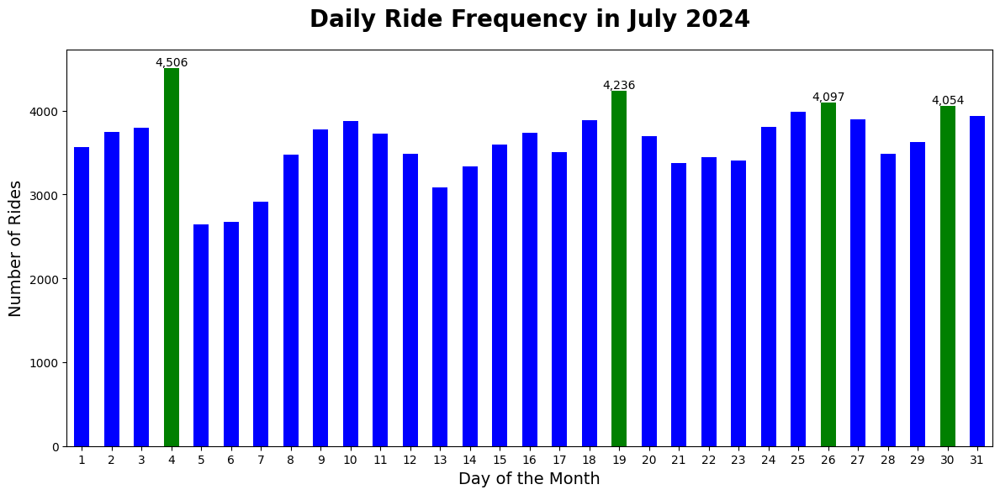

In [ ]:
import matplotlib.pyplot as plt

# Grouping data by day of the month
daily_rides = df[df['month'] == 7].groupby(df['started_at'].dt.day).size()

colors = ['green' if count > 4000 else 'blue' for count in daily_rides]

plt.figure(figsize=(12, 6))
bars = daily_rides.plot(kind='bar', color=colors)

plt.title('Daily Ride Frequency in July 2024', fontsize=20, pad=20, weight='bold')
plt.xlabel('Day of the Month', fontsize=14)
plt.ylabel('Number of Rides', fontsize=14)

for i in bars.patches:
    if i.get_height() > 4000:
        bars.annotate(f'{i.get_height():,.0f}',
                      (i.get_x() + i.get_width() / 2, i.get_height()),
                      ha='center', va='bottom', fontsize=10, color='black')

plt.xticks(rotation=0)

# Show the plot
plt.tight_layout()
plt.show()


<ipython-input-19-c676d8847065>:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['week_of_month'] = df['started_at'].dt.day // 7 + 1


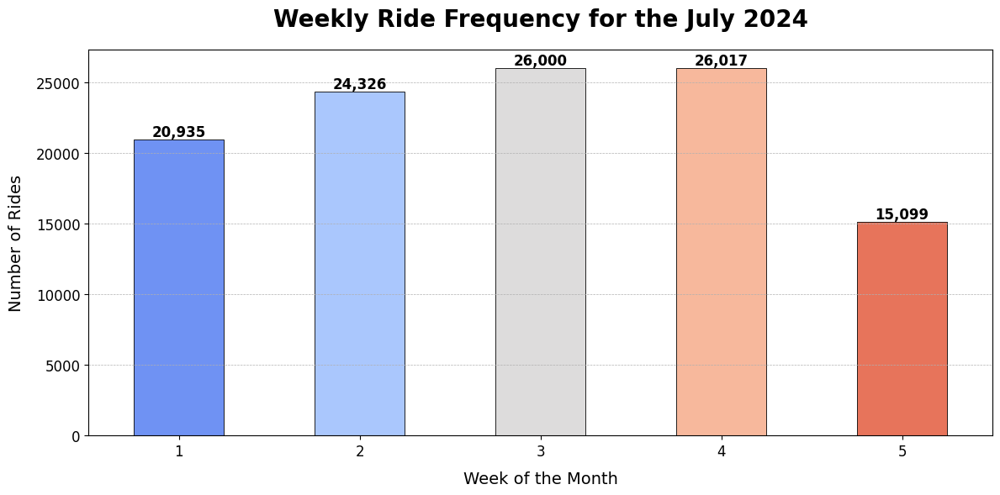

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Filter for the month of July
df = df[df['started_at'].dt.month == 7]

# Calculate week of the month
df['week_of_month'] = df['started_at'].dt.day // 7 + 1

# Group by week of the month
weekly_rides = df.groupby('week_of_month').size()


color = sns.color_palette("coolwarm", len(weekly_rides))
plt.figure(figsize=(12, 6))
bars = weekly_rides.plot(kind='bar', color=color, edgecolor='black', linewidth=0.6)

plt.title('Weekly Ride Frequency for the July 2024', fontsize=20, pad=20, weight='bold')
plt.xlabel('Week of the Month', fontsize=14, labelpad=10)
plt.ylabel('Number of Rides', fontsize=14, labelpad=10)

for i in bars.patches:
    bars.annotate(f'{i.get_height():,.0f}',
                  (i.get_x() + i.get_width() / 2, i.get_height()),
                  ha='center', va='bottom', fontsize=12, color='black', weight='bold')

plt.grid(True, which='both', axis='y', linestyle='--', linewidth=0.5)
plt.xticks(rotation=0, fontsize=12)
plt.yticks(fontsize=12)
plt.gca().set_facecolor('#0000')
plt.tight_layout()
plt.show()


<ipython-input-20-dfa2a5571503>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['day_of_week'] = df['started_at'].dt.day_name()


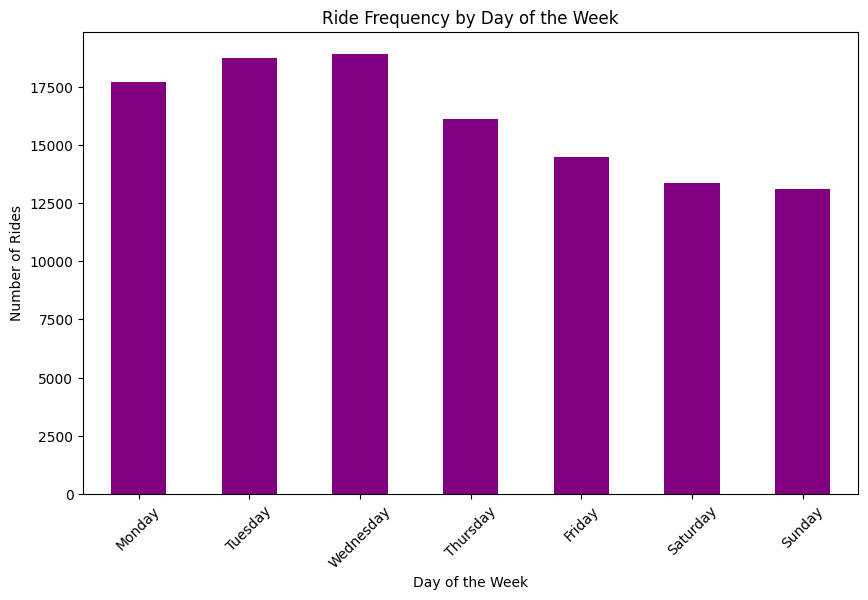

In [ ]:
# Create a column for the day of the week
df['day_of_week'] = df['started_at'].dt.day_name()

# Count rides by day of the week
weekday_rides = df.groupby('day_of_week').size()
days_of_week = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']

# Sorting based on day of the week order
weekday_rides = weekday_rides.reindex(days_of_week)

# Plotting
plt.figure(figsize=(10, 6))
weekday_rides.plot(kind='bar', color='purple')
plt.title('Ride Frequency by Day of the Week')
plt.xlabel('Day of the Week')
plt.ylabel('Number of Rides')
plt.xticks(rotation=45)
plt.show()


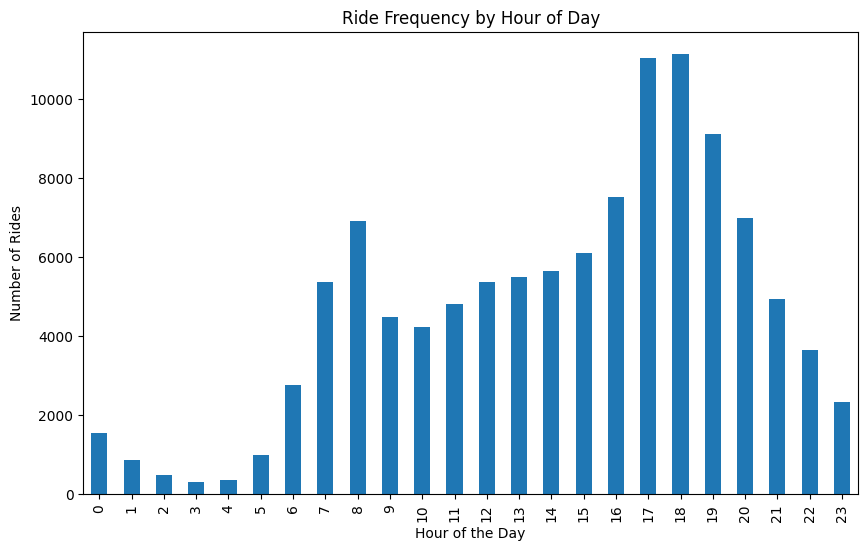

In [ ]:
# Plotting the number of rides per hour
plt.figure(figsize=(10, 6))
df['hour'].value_counts().sort_index().plot(kind='bar')
plt.title('Ride Frequency by Hour of Day')
plt.xlabel('Hour of the Day')
plt.ylabel('Number of Rides')
plt.show()

<ipython-input-22-e1a324727674>:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['time_segment'] = df['hour'].apply(time_segment)


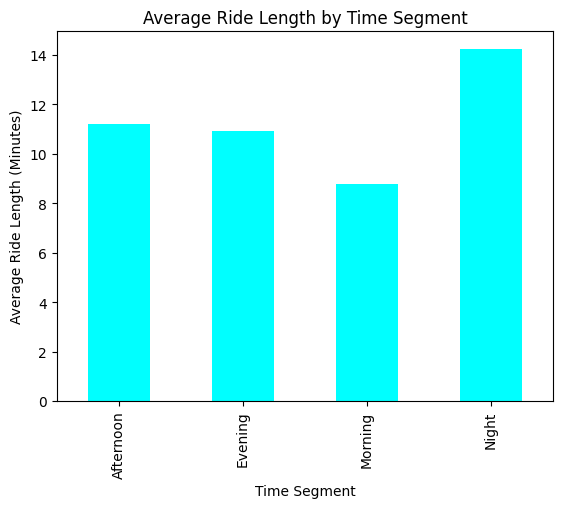

In [ ]:
# Defining time segments
def time_segment(hour):
    if 5 <= hour < 12:
        return 'Morning'
    elif 12 <= hour < 17:
        return 'Afternoon'
    elif 17 <= hour < 21:
        return 'Evening'
    else:
        return 'Night'

df['time_segment'] = df['hour'].apply(time_segment)

# Analyzing ride lengths by time segment
time_segment_analysis = df.groupby('time_segment')['ride_length_min'].mean()

# Plotting
time_segment_analysis.plot(kind='bar', color='cyan', title='Average Ride Length by Time Segment')
plt.xlabel('Time Segment')
plt.ylabel('Average Ride Length (Minutes)')
plt.show()


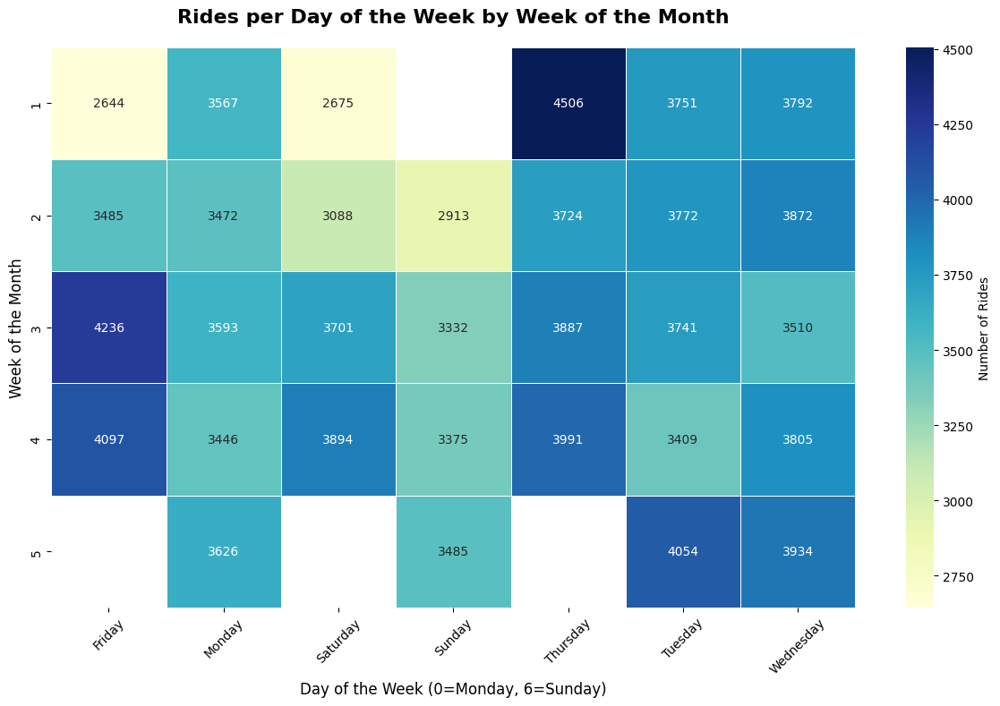

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Grouping by both week of month and day of the week
weekly_daily_rides = df.groupby(['week_of_month', 'day_of_week']).size().unstack()


# Plotting
plt.figure(figsize=(12, 8))
sns.heatmap(weekly_daily_rides,
            annot=True,
            fmt='.0f',
            cmap='YlGnBu',
            linewidths=0.5,
            linecolor='white',
            cbar_kws={'label': 'Number of Rides'},
            annot_kws={"size": 10})

plt.title('Rides per Day of the Week by Week of the Month', fontsize=16, pad=20, weight='bold')
plt.xlabel('Day of the Week (0=Monday, 6=Sunday)', fontsize=12)
plt.ylabel('Week of the Month', fontsize=12)

plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


<ipython-input-24-a0f82fc53656>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['day_type'] = df['started_at'].dt.weekday.apply(lambda x: 'Weekend' if x >= 5 else 'Weekday')


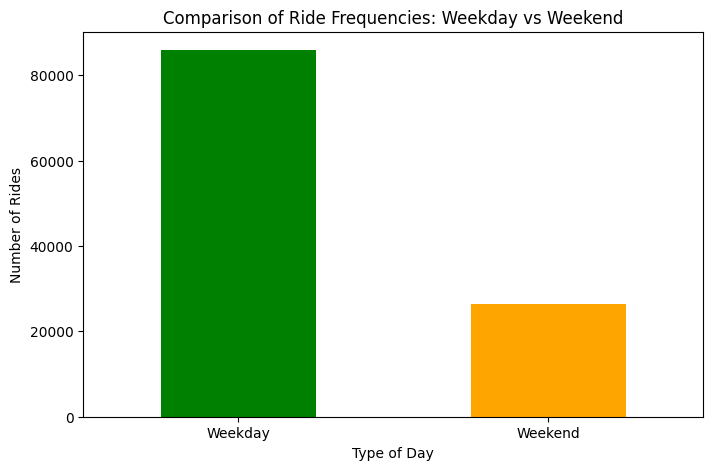

In [ ]:
# Add a column to differentiate between weekday and weekend
df['day_type'] = df['started_at'].dt.weekday.apply(lambda x: 'Weekend' if x >= 5 else 'Weekday')

# Group by 'day_type' and count rides
day_type_rides = df.groupby('day_type').size()

# Plotting
plt.figure(figsize=(8, 5))
day_type_rides.plot(kind='bar', color=['green', 'orange'])
plt.title('Comparison of Ride Frequencies: Weekday vs Weekend')
plt.xlabel('Type of Day')
plt.ylabel('Number of Rides')
plt.xticks(rotation=0)
plt.show()


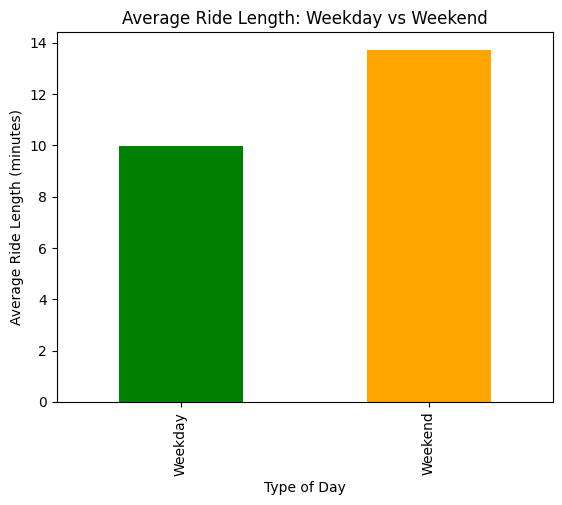

In [ ]:
# Calculate average ride length (in minutes) for weekday vs weekend
avg_ride_length = df.groupby('day_type')['ride_length_min'].mean()

# Plotting the average ride length for weekdays and weekends
avg_ride_length.plot(kind='bar', color=['green', 'orange'])
plt.title('Average Ride Length: Weekday vs Weekend')
plt.xlabel('Type of Day')
plt.ylabel('Average Ride Length (minutes)')
plt.show()


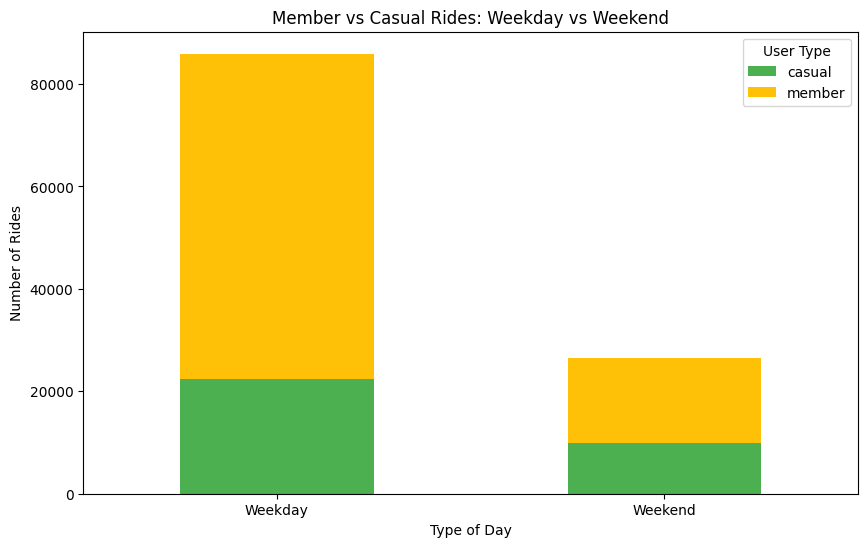

In [ ]:
# Group by day type and user type (member vs casual)
member_casual_day_type = df.groupby(['day_type', 'member_casual']).size().unstack()

# Plotting member vs casual ride distribution for weekdays and weekends
member_casual_day_type.plot(kind='bar', stacked=True, color=['#4CAF50', '#FFC107'], figsize=(10, 6))
plt.title('Member vs Casual Rides: Weekday vs Weekend')
plt.xlabel('Type of Day')
plt.ylabel('Number of Rides')
plt.xticks(rotation=0)
plt.legend(title='User Type')
plt.show()


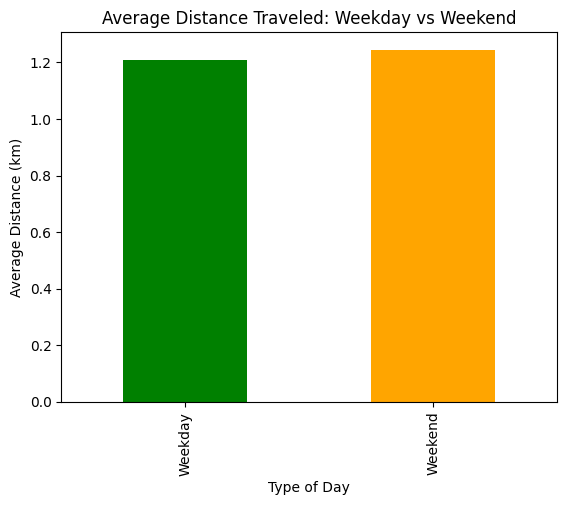

In [ ]:
# Calculate average distance for weekday vs weekend
avg_ride_distance = df.groupby('day_type')['station_distance_km'].mean()

# Plotting the average distance traveled for weekdays and weekends
avg_ride_distance.plot(kind='bar', color=['green', 'orange'])
plt.title('Average Distance Traveled: Weekday vs Weekend')
plt.xlabel('Type of Day')
plt.ylabel('Average Distance (km)')
plt.show()


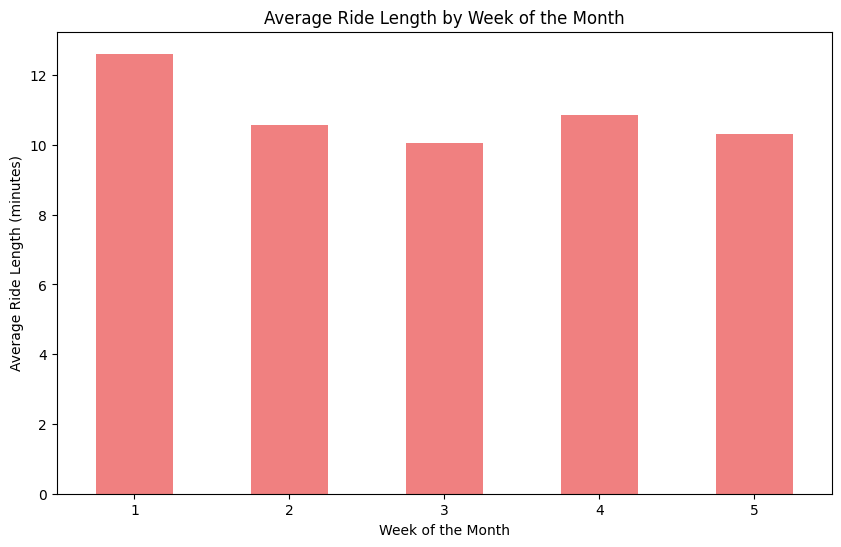

In [ ]:
# Calculate average ride length per week of the month
average_ride_length = df.groupby('week_of_month')['ride_length_min'].mean()

# Plotting
plt.figure(figsize=(10, 6))
average_ride_length.plot(kind='bar', color='lightcoral')
plt.title('Average Ride Length by Week of the Month')
plt.xlabel('Week of the Month')
plt.ylabel('Average Ride Length (minutes)')
plt.xticks(rotation=0)
plt.show()


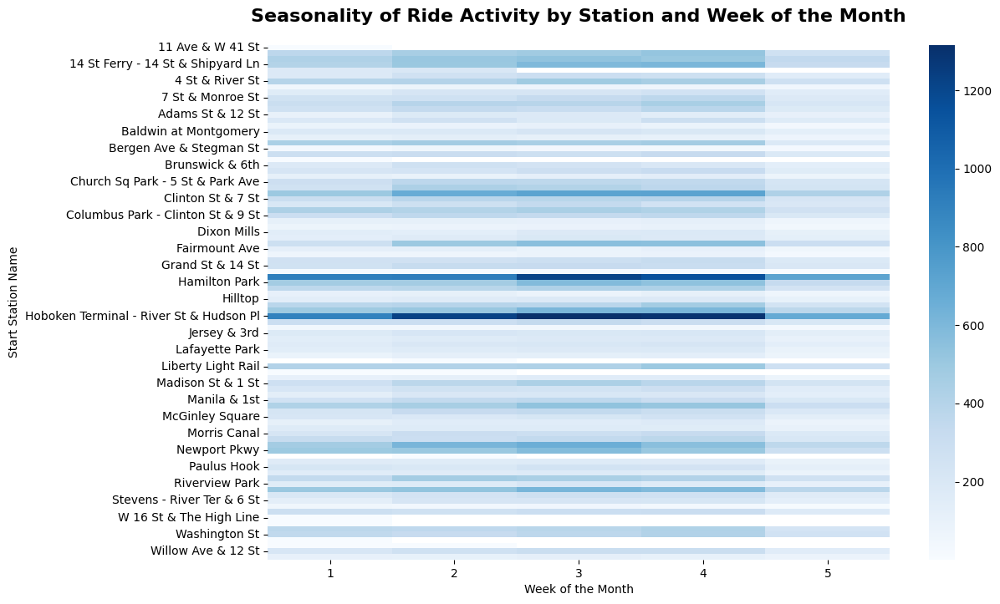

In [ ]:
# Group by start station and week of the month
station_weekly_rides = df.groupby(['start_station_name', 'week_of_month']).size().unstack()

# Plot heatmap of ride frequency across different stations for the month
plt.figure(figsize=(12, 8))
sns.heatmap(station_weekly_rides, cmap='Blues', annot=False)
plt.title('Seasonality of Ride Activity by Station and Week of the Month', fontsize=16, pad=20, weight='bold')
plt.xlabel('Week of the Month')
plt.ylabel('Start Station Name')
plt.show()


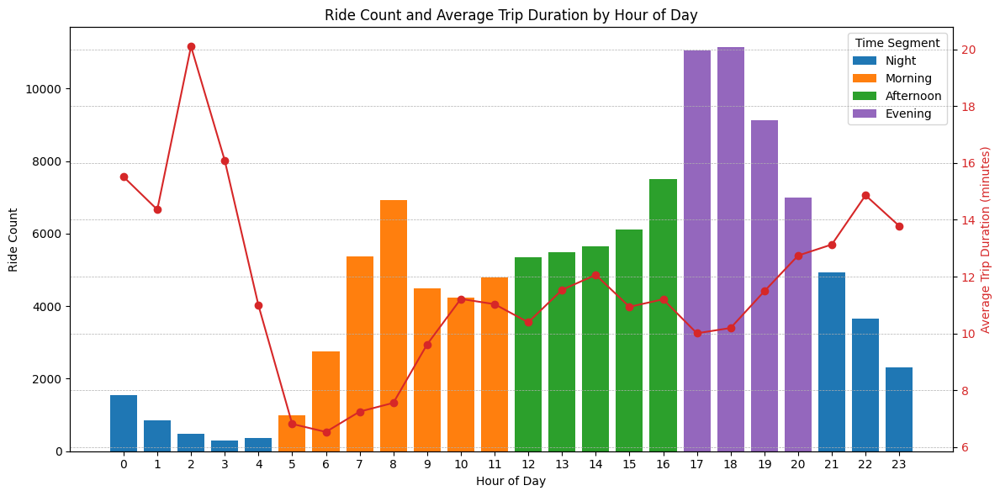

In [ ]:
hourly_stats = df.groupby(['hour', 'time_segment'])['ride_length_min'].agg(['count', 'mean']).reset_index()

segment_colors = {
    'Night': '#1f77b4',
    'Morning': '#ff7f0e',
    'Afternoon': '#2ca02c',
    'Evening': '#9467bd'
}

fig, ax1 = plt.subplots(figsize=(12, 6))


# Plot the bar chart for ride counts, colored by time segment
for segment in segment_colors.keys():
    segment_data = hourly_stats[hourly_stats['time_segment'] == segment]
    ax1.bar(segment_data['hour'], segment_data['count'], color=segment_colors[segment], label=segment)


ax1.set_xlabel('Hour of Day')
ax1.set_ylabel('Ride Count')
ax1.tick_params(axis='y')
ax1.legend(title='Time Segment', loc='upper right')

ax2 = ax1.twinx()
ax2.set_ylabel('Average Trip Duration (minutes)', color='tab:red')
ax2.plot(hourly_stats['hour'], hourly_stats['mean'], color='tab:red', marker='o')
ax2.tick_params(axis='y', labelcolor='tab:red')

plt.title('Ride Count and Average Trip Duration by Hour of Day')
plt.xticks(hourly_stats['hour'])
plt.grid(True, which='both', linestyle='--', linewidth=0.5)

plt.tight_layout()
plt.show()

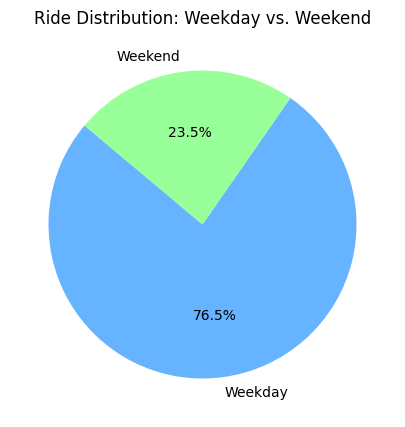

In [ ]:
# Grouping data by day type
type_day_rides = df.groupby('day_type').size()

# Plotting
plt.figure(figsize=(8, 5))
type_day_rides.plot(kind='pie', autopct='%1.1f%%', startangle=140, colors=['#66b3ff','#99ff99'])
plt.title('Ride Distribution: Weekday vs. Weekend')
plt.ylabel('')
plt.show()

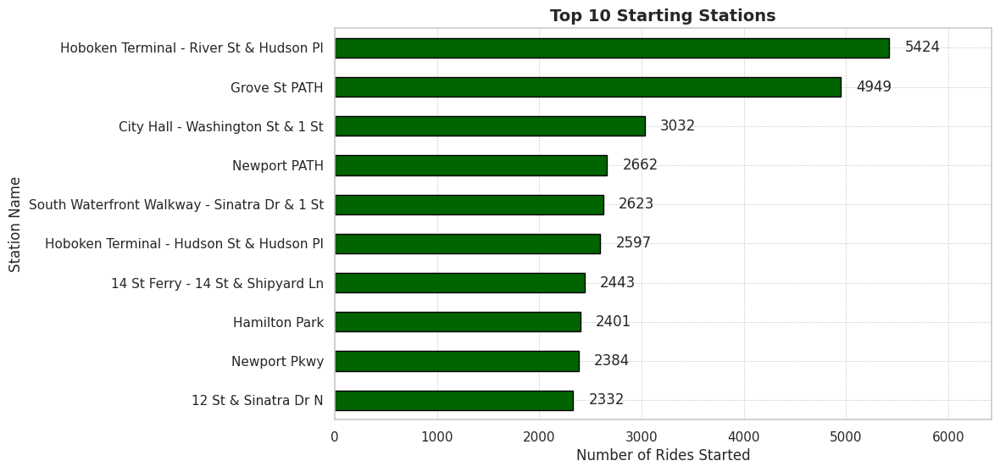

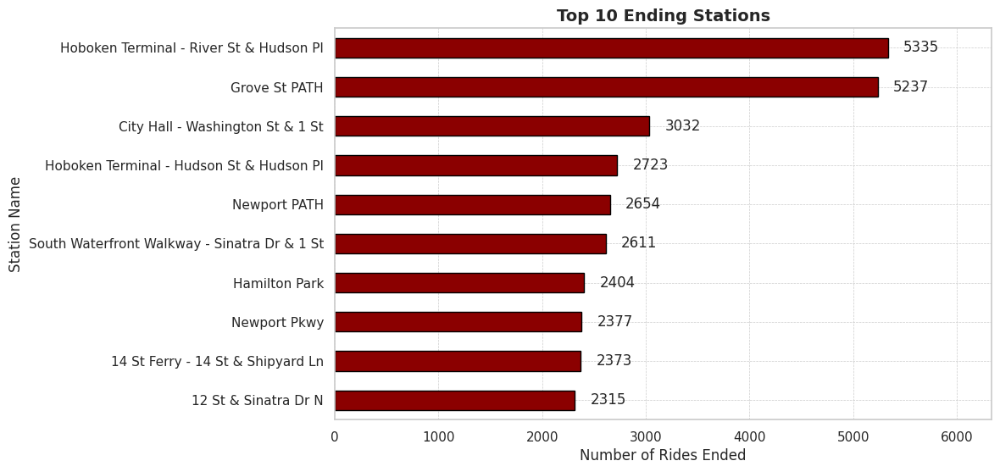

In [ ]:

sns.set(style="whitegrid")

# Count rides starting at each station
station_usage_starts = df.groupby('start_station_name').size().sort_values(ascending=False)

# Count rides ending at each station
station_usage_ends = df.groupby('end_station_name').size().sort_values(ascending=False)


def add_annotations(ax):
    for p in ax.patches:
        ax.annotate(f'{int(p.get_width())}',
                    (p.get_width() + 150, p.get_y() + p.get_height() / 2),
                    ha='left', va='center')

# Plotting top 10 stations for starts
plt.figure(figsize=(10, 6))
ax1 = station_usage_starts.head(10).sort_values().plot(kind='barh', color='darkgreen', edgecolor='black')
plt.title('Top 10 Starting Stations', fontsize=14, weight='bold')
plt.xlabel('Number of Rides Started', fontsize=12)
plt.ylabel('Station Name', fontsize=12)
plt.xlim(0, station_usage_starts.head(1).max() + 1000)
add_annotations(ax1)
plt.grid(True, which='major', linestyle='--', linewidth=0.5)
plt.show()

# Plotting top 10 stations for ends
plt.figure(figsize=(10, 6))
ax2 = station_usage_ends.head(10).sort_values().plot(kind='barh', color='darkred', edgecolor='black')
plt.title('Top 10 Ending Stations', fontsize=14, weight='bold')
plt.xlabel('Number of Rides Ended', fontsize=12)
plt.ylabel('Station Name', fontsize=12)
plt.xlim(0, station_usage_ends.head(1).max() + 1000)
add_annotations(ax2)
plt.grid(True, which='major', linestyle='--', linewidth=0.5)
plt.show()



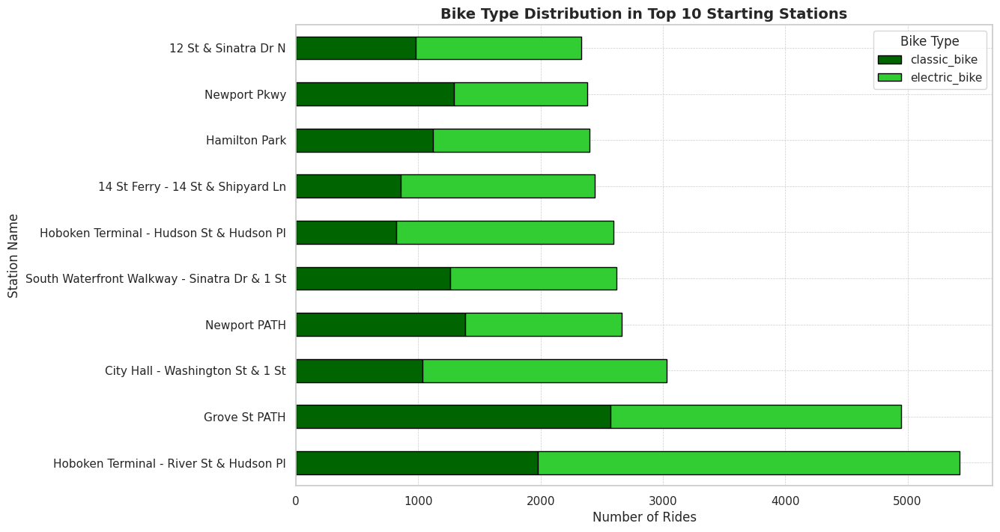

In [ ]:
sns.set(style="whitegrid")

# Group by start station and rideable type (assuming 'rideable_type' is the column for bike type)
station_bike_type = df.groupby(['start_station_name', 'rideable_type']).size().unstack().fillna(0)

# Sort by the total number of rides and select top 10 stations
top_10_stations = station_bike_type.sum(axis=1).sort_values(ascending=False).head(10)

# Filter for only the top 10 stations
top_10_station_bike_type = station_bike_type.loc[top_10_stations.index]

# Plotting stacked bar chart for bike type distribution in the top 10 stations
plt.figure(figsize=(12, 8))
top_10_station_bike_type.plot(kind='barh', stacked=True, ax=plt.gca(), edgecolor='black', color=['darkgreen', 'limegreen', 'lightgreen'])
plt.title('Bike Type Distribution in Top 10 Starting Stations', fontsize=14, weight='bold')
plt.xlabel('Number of Rides', fontsize=12)
plt.ylabel('Station Name', fontsize=12)
plt.legend(title='Bike Type')
plt.grid(True, which='major', linestyle='--', linewidth=0.5)
plt.show()


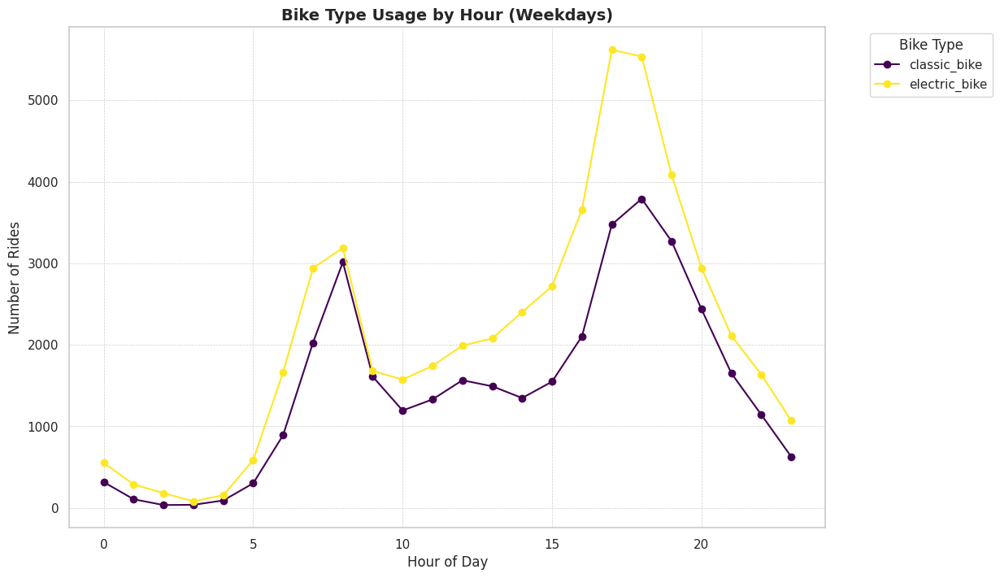

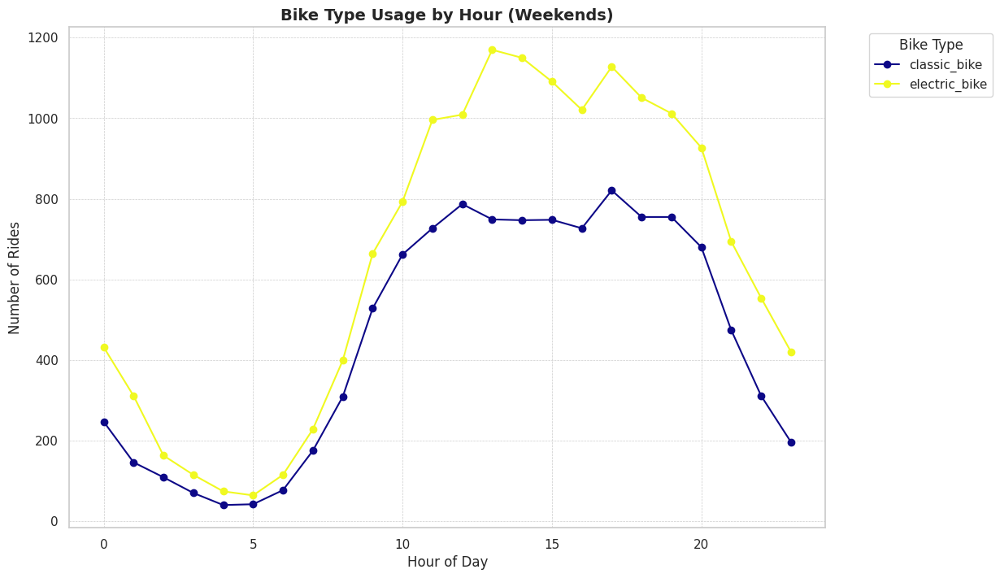

In [ ]:
# Group by hour, day_type (weekday/weekend), and rideable_type (bike type)
hourly_bike_usage = df.groupby(['hour', 'day_type', 'rideable_type']).size().unstack().fillna(0)


# Plot for Weekdays
plt.figure(figsize=(12, 8))
hourly_bike_usage.xs('Weekday', level='day_type').plot(kind='line', marker='o', colormap='viridis', ax=plt.gca())
plt.title('Bike Type Usage by Hour (Weekdays)', fontsize=14, weight='bold')
plt.xlabel('Hour of Day', fontsize=12)
plt.ylabel('Number of Rides', fontsize=12)
plt.grid(True, which='major', linestyle='--', linewidth=0.5)
plt.legend(title='Bike Type', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

# Plot for Weekends
plt.figure(figsize=(12, 8))
hourly_bike_usage.xs('Weekend', level='day_type').plot(kind='line', marker='o', colormap='plasma', ax=plt.gca())
plt.title('Bike Type Usage by Hour (Weekends)', fontsize=14, weight='bold')
plt.xlabel('Hour of Day', fontsize=12)
plt.ylabel('Number of Rides', fontsize=12)
plt.grid(True, which='major', linestyle='--', linewidth=0.5)
plt.legend(title='Bike Type', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()


<Figure size 1000x600 with 0 Axes>

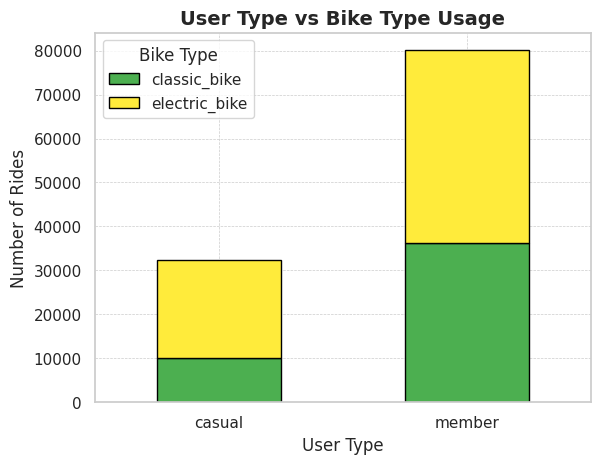

In [ ]:
# Grouping by user type (member/casual) and bike type (classic/electric)
user_bike_usage = df.groupby(['member_casual', 'rideable_type']).size().unstack()

# total usage by user type and bike type
plt.figure(figsize=(10, 6))
user_bike_usage.plot(kind='bar', stacked=True, color=['#4CAF50', '#FFEB3B'], edgecolor='black')
plt.title('User Type vs Bike Type Usage', fontsize=14, weight='bold')
plt.xlabel('User Type', fontsize=12)
plt.ylabel('Number of Rides', fontsize=12)
plt.xticks(rotation=0)
plt.legend(title='Bike Type', loc='upper left')
plt.grid(True, which='major', linestyle='--', linewidth=0.5)
plt.show()



<ipython-input-35-c7ff073d0fcf>:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(y=top_routes['start_station_name'] + ' -> ' + top_routes['end_station_name'],


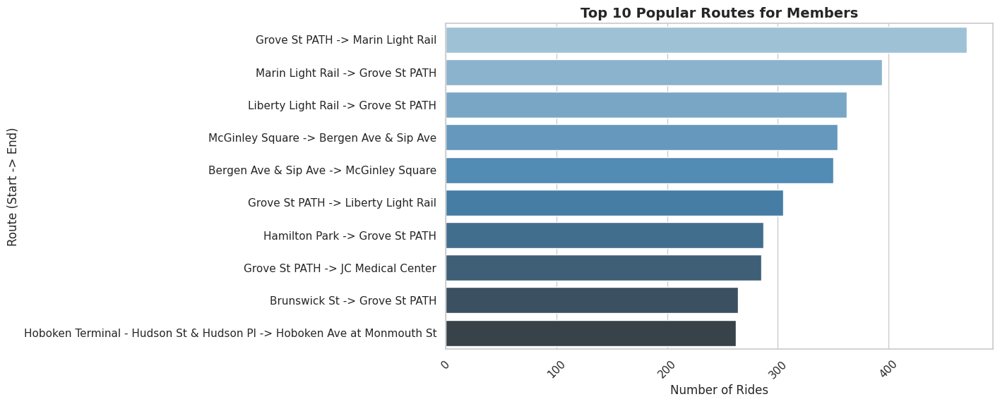

<ipython-input-35-c7ff073d0fcf>:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(y=top_routes['start_station_name'] + ' -> ' + top_routes['end_station_name'],


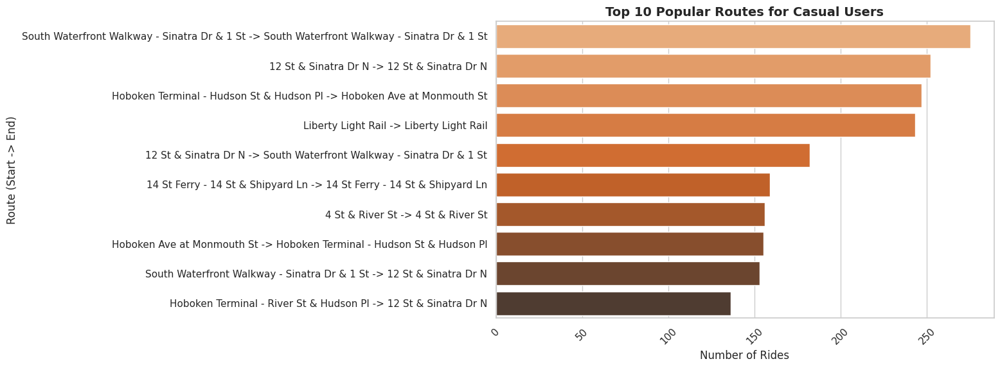

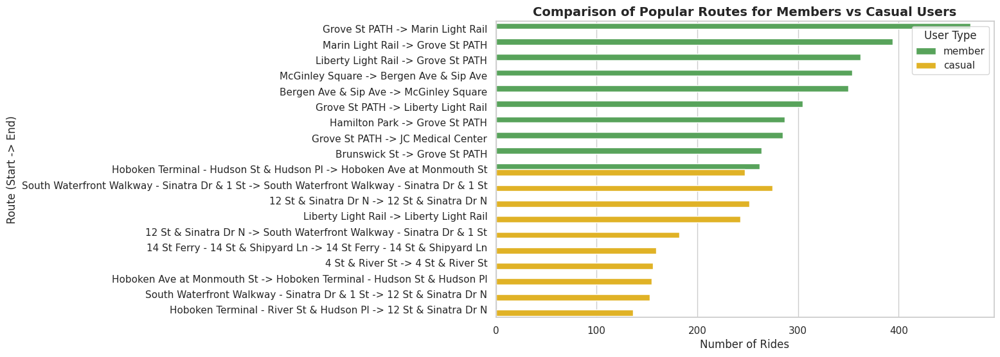

In [ ]:
# Grouping by start and end station for each user type (member and casual)
popular_routes = df.groupby(['member_casual', 'start_station_name', 'end_station_name']).size().reset_index(name='ride_count')

member_routes = popular_routes[popular_routes['member_casual'] == 'member']
casual_routes = popular_routes[popular_routes['member_casual'] == 'casual']

# Sort and get the top 10 routes for each user type
top_member_routes = member_routes.sort_values(by='ride_count', ascending=False).head(10)
top_casual_routes = casual_routes.sort_values(by='ride_count', ascending=False).head(10)

# popular routes for each user type
def plot_top_routes(top_routes, title, color):
    plt.figure(figsize=(10, 6))
    sns.barplot(y=top_routes['start_station_name'] + ' -> ' + top_routes['end_station_name'],
                x=top_routes['ride_count'], palette=color)
    plt.title(title, fontsize=14, weight='bold')
    plt.xlabel('Number of Rides', fontsize=12)
    plt.ylabel('Route (Start -> End)', fontsize=12)
    plt.xticks(rotation=45)
    plt.show()

# Plot top routes for members
plot_top_routes(top_member_routes, 'Top 10 Popular Routes for Members', sns.color_palette("Blues_d", 10))

# Plot top routes for casual users
plot_top_routes(top_casual_routes, 'Top 10 Popular Routes for Casual Users', sns.color_palette("Oranges_d", 10))

top_combined_routes = pd.concat([top_member_routes, top_casual_routes])
top_combined_routes['route'] = top_combined_routes['start_station_name'] + ' -> ' + top_combined_routes['end_station_name']

# Plot combined routes for comparison
plt.figure(figsize=(10, 6))
sns.barplot(y='route', x='ride_count', hue='member_casual', data=top_combined_routes, palette=['#4CAF50', '#FFC107'])
plt.title('Comparison of Popular Routes for Members vs Casual Users', fontsize=14, weight='bold')
plt.xlabel('Number of Rides', fontsize=12)
plt.ylabel('Route (Start -> End)', fontsize=12)
plt.legend(title='User Type', loc='upper right')
plt.show()


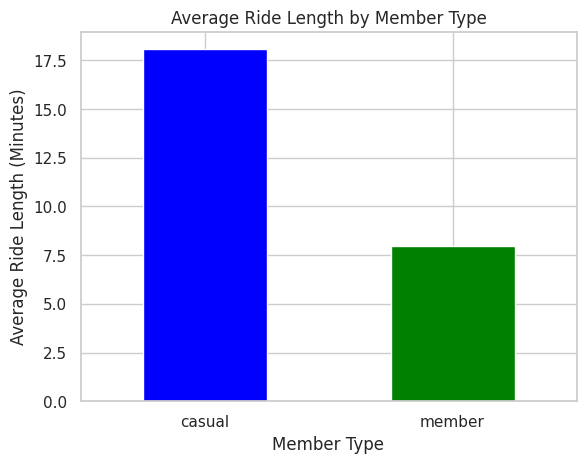

In [ ]:
# Grouping data by membership type and calculating average and median ride lengths
ride_stats_by_type = df.groupby('member_casual').agg({
    'ride_length_min': ['mean', 'median', 'std']
})

# Visualizing the differences in ride duration
ride_stats_by_type['ride_length_min']['mean'].plot(kind='bar', color=['blue', 'green'], title='Average Ride Length by Member Type')
plt.xlabel('Member Type')
plt.ylabel('Average Ride Length (Minutes)')
plt.xticks(rotation=0)
plt.show()


In [ ]:
import geopandas as gpd
import pandas as pd
import folium
from folium.plugins import HeatMap

gdf = gpd.GeoDataFrame(df, geometry=gpd.points_from_xy(df.start_lng, df.start_lat))

# Extracting lat-lng data for the heatmap
heatmap_data = gdf[['start_lat', 'start_lng']].values.tolist()

map_folium = folium.Map(location=[40.738, -73.98], zoom_start=12)

HeatMap(
    heatmap_data,
    radius=15,
    max_zoom=13,
    min_opacity=0.5,
    max_val=1.0,
    blur=15,
    gradient={0.4: 'blue', 0.65: 'lime', 1: 'red'}
).add_to(map_folium)

map_folium


<ipython-input-39-82066bd1f057>:17: UserWarning: The `max_val` parameter is no longer necessary. The largest intensity is calculated automatically.
  HeatMap(


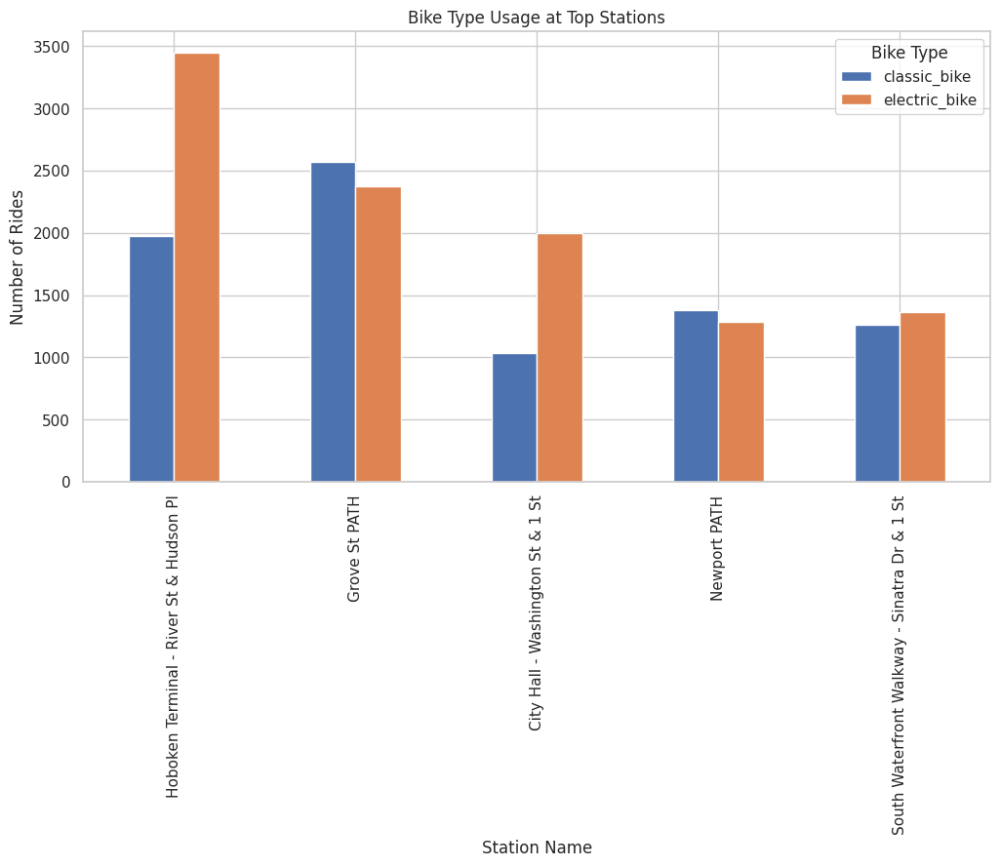

In [ ]:
# Group data by station and bike type, then count rides
station_bike_usage = df.groupby(['start_station_name', 'rideable_type']).size().unstack(fill_value=0)

# Plot top 5 stations
top_stations = station_bike_usage.sum(axis=1).nlargest(5).index
station_bike_usage.loc[top_stations].plot(kind='bar', figsize=(12, 6))
plt.title('Bike Type Usage at Top Stations')
plt.xlabel('Station Name')
plt.ylabel('Number of Rides')
plt.legend(title='Bike Type')
plt.show()


<ipython-input-41-00be384d97ea>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['route'] = df['start_station_name'] + ' to ' + df['end_station_name']


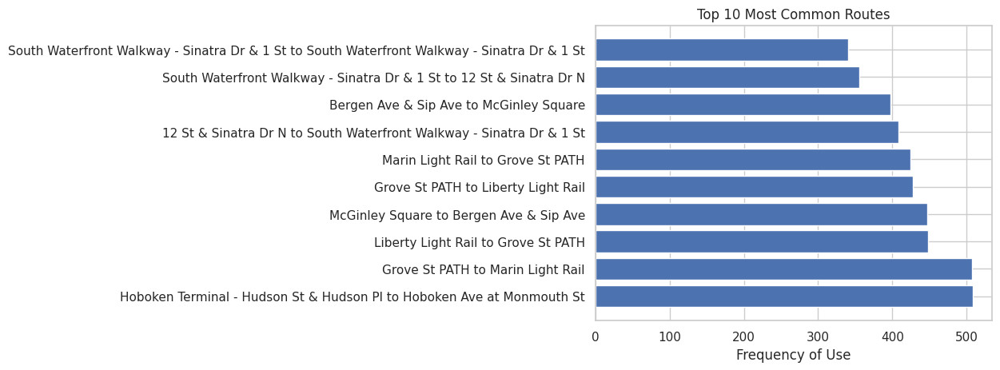

In [ ]:
from collections import Counter

# Identify common routes
df['route'] = df['start_station_name'] + ' to ' + df['end_station_name']
common_routes = Counter(df['route']).most_common(10)

# Visualization of common routes
routes, counts = zip(*common_routes)
plt.barh(routes, counts)
plt.xlabel('Frequency of Use')
plt.title('Top 10 Most Common Routes')
plt.show()


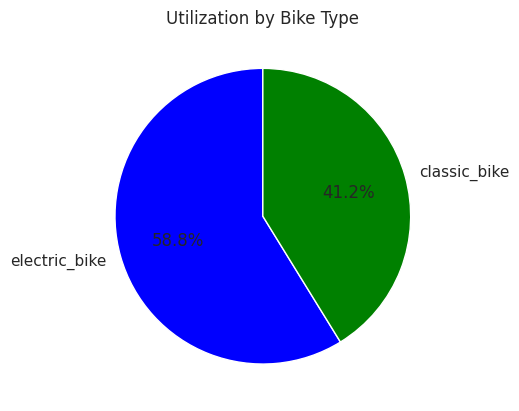

In [ ]:
# Count rides by bike type
bike_usage = df['rideable_type'].value_counts()

# Plotting
bike_usage.plot(kind='pie', autopct='%1.1f%%', startangle=90, colors=['blue', 'green', 'red'])
plt.title('Utilization by Bike Type')
plt.ylabel('')
plt.show()


In [ ]:
# Total number of rides and overall average ride length
total_rides = df.shape[0]
average_ride_length = df['ride_length_min'].mean()

print(f"Total Rides: {total_rides}")
print(f"Average Ride Length: {average_ride_length:.2f} minutes")


Total Rides: 112377
Average Ride Length: 10.86 minutes


In [ ]:
# Aggregate ride counts by start and end stations
start_station_counts = df.groupby(['start_station_name', 'start_station_id', 'start_lat', 'start_lng']).size().reset_index(name='start_count')
end_station_counts = df.groupby(['end_station_name', 'end_station_id', 'end_lat', 'end_lng']).size().reset_index(name='end_count')
import folium
from folium.plugins import MarkerCluster

# Create base map
map = folium.Map(location=[40.738, -73.98], zoom_start=12)

marker_cluster = MarkerCluster().add_to(map)

for idx, row in start_station_counts.iterrows():
    folium.CircleMarker(
        location=(row['start_lat'], row['start_lng']),
        radius=row['start_count']*0.05,
        color='blue',
        fill=True,
        fill_color='blue',
        fill_opacity=0.6,
        popup=f"{row['start_station_name']} (Starts: {row['start_count']})"
    ).add_to(marker_cluster)

for idx, row in end_station_counts.iterrows():
    folium.CircleMarker(
        location=(row['end_lat'], row['end_lng']),
        radius=row['end_count']*0.05,
        color='green',
        fill=True,
        fill_color='green',
        fill_opacity=0.6,
        popup=f"{row['end_station_name']} (Ends: {row['end_count']})"  # Popup text
    ).add_to(marker_cluster)

map.save('citi_bike_station_map.html')
map


In [ ]:
# Finding the busiest start station
busiest_start_station = df['start_station_name'].value_counts().idxmax()
busiest_start_count = df['start_station_name'].value_counts().max()

# Finding the busiest end station
busiest_end_station = df['end_station_name'].value_counts().idxmax()
busiest_end_count = df['end_station_name'].value_counts().max()

print(f"Busiest Start Station: {busiest_start_station} with {busiest_start_count} rides")
print(f"Busiest End Station: {busiest_end_station} with {busiest_end_count} rides")


Busiest Start Station: Hoboken Terminal - River St & Hudson Pl with 5424 rides
Busiest End Station: Hoboken Terminal - River St & Hudson Pl with 5335 rides


In [ ]:
# Group by 'day_type' and then find the busiest stations for each type
grouped = df.groupby('day_type')

busiest_by_day_type = grouped['start_station_name'].agg(lambda x: x.value_counts().idxmax())
counts_by_day_type = grouped['start_station_name'].agg(lambda x: x.value_counts().max())

# Output busiest stations by day type for starts
print("Busiest Start Stations by Day Type:")
print(busiest_by_day_type)
print(counts_by_day_type)

# Repeat for end stations
busiest_by_day_type_ends = grouped['end_station_name'].agg(lambda x: x.value_counts().idxmax())
counts_by_day_type_ends = grouped['end_station_name'].agg(lambda x: x.value_counts().max())

# Output busiest stations by day type for ends
print("\nBusiest End Stations by Day Type:")
print(busiest_by_day_type_ends)
print(counts_by_day_type_ends)


Busiest Start Stations by Day Type:
day_type
Weekday    Hoboken Terminal - River St & Hudson Pl
Weekend    Hoboken Terminal - River St & Hudson Pl
Name: start_station_name, dtype: object
day_type
Weekday    4243
Weekend    1181
Name: start_station_name, dtype: int64

Busiest End Stations by Day Type:
day_type
Weekday    Hoboken Terminal - River St & Hudson Pl
Weekend    Hoboken Terminal - River St & Hudson Pl
Name: end_station_name, dtype: object
day_type
Weekday    4250
Weekend    1085
Name: end_station_name, dtype: int64


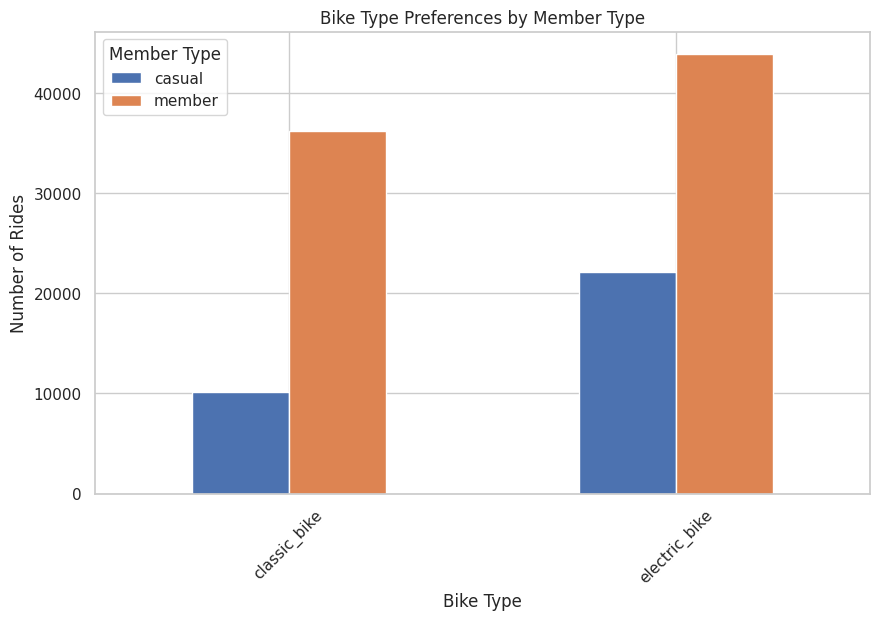

In [ ]:
# Count of rides by bike type and member type
bike_type_preferences = df.groupby(['rideable_type', 'member_casual']).size().unstack()

# Visualize the data
bike_type_preferences.plot(kind='bar', figsize=(10, 6))
plt.title('Bike Type Preferences by Member Type')
plt.xlabel('Bike Type')
plt.ylabel('Number of Rides')
plt.xticks(rotation=45)
plt.legend(title='Member Type')
plt.show()


In [ ]:
# Group by member type and route to see which routes are most popular for each type
member_casual_route = df.groupby(['member_casual', 'start_station_name', 'end_station_name']).size().reset_index(name='count')

# Analyze differences in ride frequency for members and casual users
member_data = member_casual_route[member_casual_route['member_casual'] == 'member']
casual_data = member_casual_route[member_casual_route['member_casual'] == 'casual']

# Compare top 5 routes for members and casual riders
print("Top 5 Routes for Members:")
print(member_data.sort_values(by='count', ascending=False).head(5))

print("\nTop 5 Routes for Casual Riders:")
print(casual_data.sort_values(by='count', ascending=False).head(5))


Top 5 Routes for Members:
     member_casual    start_station_name      end_station_name  count
6692        member         Grove St PATH      Marin Light Rail    471
8043        member      Marin Light Rail         Grove St PATH    394
7667        member    Liberty Light Rail         Grove St PATH    362
8167        member       McGinley Square  Bergen Ave & Sip Ave    354
5321        member  Bergen Ave & Sip Ave       McGinley Square    350

Top 5 Routes for Casual Riders:
     member_casual                            start_station_name  \
3946        casual  South Waterfront Walkway - Sinatra Dr & 1 St   
62          casual                          12 St & Sinatra Dr N   
2390        casual      Hoboken Terminal - Hudson St & Hudson Pl   
2820        casual                            Liberty Light Rail   
113         casual                          12 St & Sinatra Dr N   

                                  end_station_name  count  
3946  South Waterfront Walkway - Sinatra Dr & 1 St  

In [ ]:
# Group by start and end station to understand the movement between stations
bike_movement = df.groupby(['start_station_name', 'end_station_name']).size().reset_index(name='ride_count')

# Sort to identify the most common bike movements
common_bike_movement = bike_movement.sort_values(by='ride_count', ascending=False)
print(common_bike_movement.head(10))


                                start_station_name  \
3071      Hoboken Terminal - Hudson St & Hudson Pl   
2619                                 Grove St PATH   
3684                            Liberty Light Rail   
4224                               McGinley Square   
2612                                 Grove St PATH   
4093                              Marin Light Rail   
133                           12 St & Sinatra Dr N   
1089                          Bergen Ave & Sip Ave   
5129  South Waterfront Walkway - Sinatra Dr & 1 St   
5193  South Waterfront Walkway - Sinatra Dr & 1 St   

                                  end_station_name  ride_count  
3071                    Hoboken Ave at Monmouth St         509  
2619                              Marin Light Rail         507  
3684                                 Grove St PATH         448  
4224                          Bergen Ave & Sip Ave         447  
2612                            Liberty Light Rail         428  
4093           

In [ ]:
# Calculate number of rides starting and ending at each station
start_counts = df.groupby('start_station_name').size().reset_index(name='start_count')
end_counts = df.groupby('end_station_name').size().reset_index(name='end_count')

# Merge the start and end counts to find imbalances
station_imbalance = pd.merge(start_counts, end_counts, left_on='start_station_name', right_on='end_station_name', how='outer').fillna(0)

# Calculate the imbalance (difference between starts and ends)
station_imbalance['imbalance'] = station_imbalance['start_count'] - station_imbalance['end_count']

# Sort by imbalance to find the stations with the most supply issues
print(station_imbalance.sort_values(by='imbalance', ascending=False).head(10))


                         start_station_name  start_count  \
45                                  Hilltop        779.0   
74                              Oakland Ave        752.0   
66                          McGinley Square       1021.0   
25                                City Hall       1710.0   
48  Hoboken Terminal - River St & Hudson Pl       5424.0   
3         14 St Ferry - 14 St & Shipyard Ln       2443.0   
53                           Journal Square        933.0   
17                     Bergen Ave & Sip Ave       2025.0   
34                         Essex Light Rail        806.0   
75                              Paulus Hook       1039.0   

                           end_station_name  end_count  imbalance  
45                                  Hilltop      618.0      161.0  
74                              Oakland Ave      606.0      146.0  
66                          McGinley Square      908.0      113.0  
25                                City Hall     1602.0      108.0  

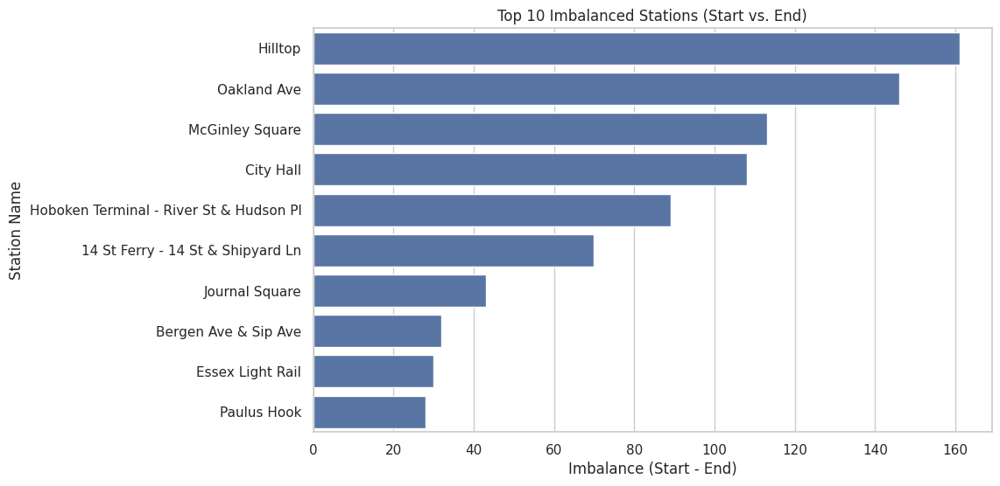

In [ ]:
# Sort by the imbalance to see where bike availability is skewed
top_10_imbalanced_stations = station_imbalance.sort_values(by='imbalance', ascending=False).head(10)

# Plot the imbalance
plt.figure(figsize=(10, 6))
sns.barplot(x='imbalance', y='start_station_name', data=top_10_imbalanced_stations)
plt.title('Top 10 Imbalanced Stations (Start vs. End)')
plt.xlabel('Imbalance (Start - End)')
plt.ylabel('Station Name')
plt.show()


In [ ]:
# Group by station and hour to find when imbalances occur
hourly_start_counts = df.groupby(['start_station_name', 'hour']).size().reset_index(name='start_count')
hourly_end_counts = df.groupby(['end_station_name', 'hour']).size().reset_index(name='end_count')

# Merge start and end counts to calculate hourly imbalances
hourly_station_imbalance = pd.merge(hourly_start_counts, hourly_end_counts, left_on=['start_station_name', 'hour'], right_on=['end_station_name', 'hour'], how='outer').fillna(0)
hourly_station_imbalance['imbalance'] = hourly_station_imbalance['start_count'] - hourly_station_imbalance['end_count']

# Sort by station and hour to find the most frequent imbalances
print(hourly_station_imbalance.sort_values(by='imbalance', ascending=False).head(10))


                           start_station_name  hour  start_count  \
1100  Hoboken Terminal - River St & Hudson Pl    17       1080.0   
933                             Grove St PATH    17        798.0   
1101  Hoboken Terminal - River St & Hudson Pl    18        854.0   
934                             Grove St PATH    18        738.0   
1099  Hoboken Terminal - River St & Hudson Pl    16        570.0   
932                             Grove St PATH    16        446.0   
398                      Bergen Ave & Sip Ave    18        292.0   
798                               Exchange Pl    17        314.0   
397                      Bergen Ave & Sip Ave    17        278.0   
1715                          River St & 1 St    18        306.0   

                             end_station_name  end_count  imbalance  
1100  Hoboken Terminal - River St & Hudson Pl      363.0      717.0  
933                             Grove St PATH      311.0      487.0  
1101  Hoboken Terminal - River St & Hudso

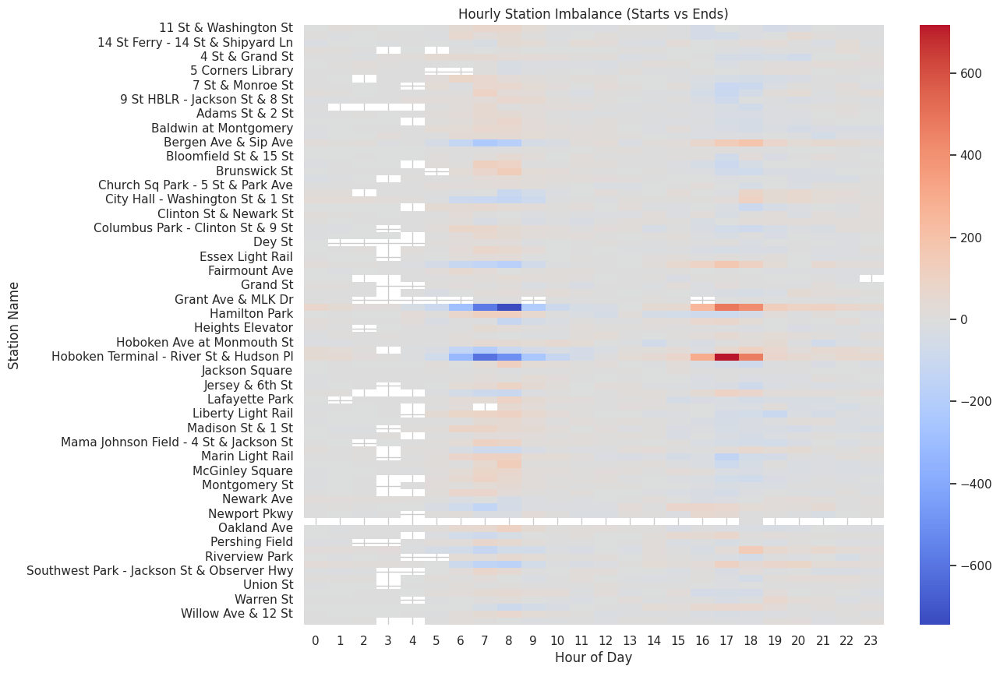

In [ ]:
hourly_station_imbalance = pd.merge(
    hourly_start_counts, hourly_end_counts,
    left_on=['start_station_name', 'hour'], right_on=['end_station_name', 'hour'],
    how='outer'
)

# Calculate imbalance
hourly_station_imbalance['imbalance'] = hourly_station_imbalance['start_count'] - hourly_station_imbalance['end_count']

pivot_imbalance = hourly_station_imbalance.pivot_table(
    index='start_station_name',
    columns='hour',
    values='imbalance'
)

# Plot the heatmap
plt.figure(figsize=(12, 10))
sns.heatmap(pivot_imbalance, cmap='coolwarm', center=0)
plt.title('Hourly Station Imbalance (Starts vs Ends)')
plt.xlabel('Hour of Day')
plt.ylabel('Station Name')
plt.show()


In [ ]:
# Group the data by date, hour, and day_of_week to count the number of rides per hour
ride_counts = df.groupby(['hour', 'day_of_week']).size().reset_index(name='ride_count')
ride_counts

,hour,day_of_week,ride_count
0,0,Friday,304
1,0,Monday,174
2,0,Saturday,334
3,0,Sunday,345
4,0,Thursday,160
...,...,...,...
163,23,Saturday,407
164,23,Sunday,209
165,23,Thursday,415
166,23,Tuesday,293


Predictive Modeling: Predicting Ride Demand

## Challenge Process:

1. **Extract Data from Citi Bike Database**:
    - Data was obtained from the Citi Bike database, containing details about ride trips, including start and end times, locations, and rider types, member_type.
    - Data Extracted : from Jan 2024 - Aug 2024 (May 2024 was not extracted due issue with citi bike database).
    - Source: https://s3.amazonaws.com/tripdata/index.html
    
2. **Load Data**:
    - The dataset was loaded into the notebook environment for processing and analysis.

3. **Data Processing**:
    - Cleaned and preprocessed the dataset:
        - Handled missing values.
        - Converted timestamps to proper formats.
        - Calculated ride lengths and other relevant metrics.
    
4. **Feature Engineering**:
    - Created additional features to enhance model performance:
        - Time-based features (hour, day of the week, season).
        - Categorical encoding of features like day type.
    
5. **Apply Algorithms**:
    - Applied various machine learning algorithms to predict ride demand:
        - **Ridge Regression**
        - **Lasso Regression**
        - **ElasticNet**
        - **Random Forest Regressor**
        - **Gradient Boosting Regressor**
        - **XGBoost Regressor**

6. **Evaluating Algorithms with Metrics**:
    - The performance of each model was evaluated using the following metrics:
        - **Root Mean Squared Error (RMSE)**
        - **Mean Absolute Error (MAE)**
        - **R² Score**


In [124]:
!mkdir -p citi_bike_zip_data_24
!mkdir -p citi_bike_extracted_data_24

#Download all the ZIP files into the zip_data folder
!wget -P citi_bike_zip_data_24 https://s3.amazonaws.com/tripdata/JC-202401-citibike-tripdata.csv.zip
!wget -P citi_bike_zip_data_24 https://s3.amazonaws.com/tripdata/JC-202402-citibike-tripdata.csv.zip
!wget -P citi_bike_zip_data_24 https://s3.amazonaws.com/tripdata/JC-202403-citibike-tripdata.csv.zip
!wget -P citi_bike_zip_data_24 https://s3.amazonaws.com/tripdata/JC-202404-citibike-tripdata.csv.zip
!wget -P citi_bike_zip_data_24 https://s3.amazonaws.com/tripdata/JC-202405-citibike-tripdata.csv.zip
!wget -P citi_bike_zip_data_24 https://s3.amazonaws.com/tripdata/JC-202406-citibike-tripdata.csv.zip
!wget -P citi_bike_zip_data_24 https://s3.amazonaws.com/tripdata/JC-202407-citibike-tripdata.csv.zip
!wget -P citi_bike_zip_data_24 https://s3.amazonaws.com/tripdata/JC-202408-citibike-tripdata.csv.zip

#Extract all ZIP files from the citi_bike_zip_data_24 folder into the citi_bike_extracted_data_24 folder
!unzip 'citi_bike_zip_data_24/*.zip' -d citi_bike_extracted_data_24


--2024-09-13 10:19:25--  https://s3.amazonaws.com/tripdata/JC-202401-citibike-tripdata.csv.zip
Resolving s3.amazonaws.com (s3.amazonaws.com)... 52.217.43.70, 52.217.83.118, 54.231.226.128, ...
Connecting to s3.amazonaws.com (s3.amazonaws.com)|52.217.43.70|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1883296 (1.8M) [application/zip]
Saving to: ‘citi_bike_zip_data_24/JC-202401-citibike-tripdata.csv.zip.1’

JC-202401-citibike- 100%[===================>]   1.80M  5.93MB/s    in 0.3s    

2024-09-13 10:19:25 (5.93 MB/s) - ‘citi_bike_zip_data_24/JC-202401-citibike-tripdata.csv.zip.1’ saved [1883296/1883296]

--2024-09-13 10:19:25--  https://s3.amazonaws.com/tripdata/JC-202402-citibike-tripdata.csv.zip
Resolving s3.amazonaws.com (s3.amazonaws.com)... 52.217.43.70, 52.217.83.118, 54.231.226.128, ...
Connecting to s3.amazonaws.com (s3.amazonaws.com)|52.217.43.70|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1908683 (1.8M) [application/zip

In [129]:
import os
import pandas as pd
folder_path = '/content/citi_bike_extracted_data_24'

# Get a list of all CSV files in the extracted folder
csv_files = [f for f in os.listdir(folder_path) if f.endswith('.csv')]

df_list = []

#  Loop over the CSV files, load each one, and append it to the list
for file in csv_files:
    file_path = os.path.join(folder_path, file)
    df = pd.read_csv(file_path)
    df_list.append(df)

# Concatenate all the DataFrames into a single DataFrame
combined_df = pd.concat(df_list, ignore_index=True)


In [130]:
# Save the combined DataFrame to a CSV file
combined_df.to_csv('combined_7_month_citi_bike_data_24.csv', index=False)
combined_df

,ride_id,rideable_type,started_at,ended_at,start_station_name,start_station_id,end_station_name,end_station_id,start_lat,start_lng,end_lat,end_lng,member_casual
0,6B61E4880B1DE1E9,electric_bike,2024-07-31 12:06:49.628,2024-07-31 12:23:59.876,14 St Ferry - 14 St & Shipyard Ln,HB202,Brunswick & 6th,JC081,40.752961,-74.024353,40.726012,-74.050389,member
1,B593705A700E04B9,electric_bike,2024-07-01 07:53:20.019,2024-07-01 08:13:56.570,Leonard Gordon Park,JC080,McGinley Square,JC055,40.745717,-74.057247,40.725340,-74.067622,member
2,19CFBBAF90BF45B8,electric_bike,2024-07-30 14:57:29.219,2024-07-30 15:10:49.553,Liberty Light Rail,JC052,Hoboken Ave at Monmouth St,JC105,40.711242,-74.055701,40.735208,-74.046964,casual
3,8E6563C41AA8A1B4,electric_bike,2024-07-17 17:02:20.147,2024-07-17 17:04:50.818,Grand St & 14 St,HB506,Madison St & 10 St,HB503,40.754090,-74.031600,40.749943,-74.035865,member
4,44065C7E4AE573FA,electric_bike,2024-07-20 17:19:44.970,2024-07-20 17:39:09.894,Hoboken Terminal - River St & Hudson Pl,HB102,Madison St & 10 St,HB503,40.736068,-74.029127,40.749943,-74.035865,casual
...,...,...,...,...,...,...,...,...,...,...,...,...,...
580975,75E5CF948A4ADB77,electric_bike,2024-01-25 20:51:27,2024-01-25 20:59:16,Willow Ave & 12 St,HB505,Clinton St & 7 St,HB303,40.751920,-74.030396,40.745420,-74.033320,casual
580976,58DD5BF65F9B9E31,electric_bike,2024-01-27 09:03:41,2024-01-27 09:08:47,Southwest Park - Jackson St & Observer Hwy,HB401,Clinton St & 7 St,HB303,40.737551,-74.041664,40.745420,-74.033320,casual
580977,F0FBCE423BE48B08,classic_bike,2024-01-28 14:46:29,2024-01-28 14:51:43,Southwest Park - Jackson St & Observer Hwy,HB401,Clinton St & 7 St,HB303,40.737551,-74.041664,40.745420,-74.033320,member
580978,7DD51CAD2DBE7990,classic_bike,2024-01-10 08:03:47,2024-01-10 08:10:55,Southwest Park - Jackson St & Observer Hwy,HB401,Clinton St & 7 St,HB303,40.737551,-74.041664,40.745420,-74.033320,casual


In [131]:
from dateutil import parser

#Define a function to parse dates and handle inconsistent formats
def parse_datetime(row):
    try:
        return parser.parse(row)
    except (ValueError, TypeError):
        return pd.NaT

# Apply the function to 'started_at' and 'ended_at' columns
combined_df['started_at'] = combined_df['started_at'].apply(parse_datetime)
combined_df['ended_at'] = combined_df['ended_at'].apply(parse_datetime)

# Remove the fractional seconds after parsing
combined_df['started_at'] = combined_df['started_at'].dt.floor('S')
combined_df['ended_at'] = combined_df['ended_at'].dt.floor('S')

combined_df.info()
print(combined_df[['started_at', 'ended_at']].head())


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 580980 entries, 0 to 580979
Data columns (total 13 columns):
 #   Column              Non-Null Count   Dtype         
---  ------              --------------   -----         
 0   ride_id             580980 non-null  object        
 1   rideable_type       580980 non-null  object        
 2   started_at          580980 non-null  datetime64[ns]
 3   ended_at            580980 non-null  datetime64[ns]
 4   start_station_name  580879 non-null  object        
 5   start_station_id    580879 non-null  object        
 6   end_station_name    579053 non-null  object        
 7   end_station_id      578923 non-null  object        
 8   start_lat           580980 non-null  float64       
 9   start_lng           580980 non-null  float64       
 10  end_lat             580759 non-null  float64       
 11  end_lng             580759 non-null  float64       
 12  member_casual       580980 non-null  object        
dtypes: datetime64[ns](2), float64

In [132]:
combined_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 580980 entries, 0 to 580979
Data columns (total 13 columns):
 #   Column              Non-Null Count   Dtype         
---  ------              --------------   -----         
 0   ride_id             580980 non-null  object        
 1   rideable_type       580980 non-null  object        
 2   started_at          580980 non-null  datetime64[ns]
 3   ended_at            580980 non-null  datetime64[ns]
 4   start_station_name  580879 non-null  object        
 5   start_station_id    580879 non-null  object        
 6   end_station_name    579053 non-null  object        
 7   end_station_id      578923 non-null  object        
 8   start_lat           580980 non-null  float64       
 9   start_lng           580980 non-null  float64       
 10  end_lat             580759 non-null  float64       
 11  end_lng             580759 non-null  float64       
 12  member_casual       580980 non-null  object        
dtypes: datetime64[ns](2), float64

In [133]:
# Convert 'start_station_id' and 'end_station_id' to string
combined_df['start_station_name'] = combined_df['start_station_name'].astype(str)
combined_df['end_station_name'] = combined_df['end_station_name'].astype(str)

In [134]:
combined_df.drop_duplicates(inplace=True)
combined_df.dropna(inplace=True)

In [135]:
combined_df.isnull().sum()

,0
ride_id,0
rideable_type,0
started_at,0
ended_at,0
start_station_name,0
start_station_id,0
end_station_name,0
end_station_id,0
start_lat,0
start_lng,0


In [136]:
def ride_length(df, unit='seconds'):
    # Define the conversion factor based on the unit provided
    if unit == 'minutes':
        divisor = pd.Timedelta(minutes=1)
        column_name = 'ride_length_min'
    elif unit == 'hours':
        divisor = pd.Timedelta(hours=1)
        column_name = 'ride_length_hr'
    else:
        # Default to seconds if input is unrecognized or 'seconds'
        divisor = pd.Timedelta(seconds=1)
        column_name = 'ride_length_sec'

    # Calculate the ride length using the appropriate divisor and set the column name dynamically
    df[column_name] = (df['ended_at'] - df['started_at']) / divisor
    df[column_name] = df[column_name].astype('int32')
    return df

combined_df = ride_length(combined_df, 'minutes')

In [138]:

combined_df['year'] = combined_df['started_at'].dt.year
combined_df['day'] = combined_df['started_at'].dt.day
combined_df['month'] = combined_df['started_at'].dt.month
combined_df['day_of_week'] = combined_df['started_at'].dt.day_name()

combined_df['hour'] = combined_df['started_at'].dt.hour
combined_df['minute'] = combined_df['started_at'].dt.minute
combined_df['second'] = combined_df['started_at'].dt.second

combined_df

,ride_id,rideable_type,started_at,ended_at,start_station_name,start_station_id,end_station_name,end_station_id,start_lat,start_lng,...,end_lng,member_casual,ride_length_min,year,day,month,day_of_week,hour,minute,second
0,6B61E4880B1DE1E9,electric_bike,2024-07-31 12:06:49,2024-07-31 12:23:59,14 St Ferry - 14 St & Shipyard Ln,HB202,Brunswick & 6th,JC081,40.752961,-74.024353,...,-74.050389,member,17,2024,31,7,Wednesday,12,6,49
1,B593705A700E04B9,electric_bike,2024-07-01 07:53:20,2024-07-01 08:13:56,Leonard Gordon Park,JC080,McGinley Square,JC055,40.745717,-74.057247,...,-74.067622,member,20,2024,1,7,Monday,7,53,20
2,19CFBBAF90BF45B8,electric_bike,2024-07-30 14:57:29,2024-07-30 15:10:49,Liberty Light Rail,JC052,Hoboken Ave at Monmouth St,JC105,40.711242,-74.055701,...,-74.046964,casual,13,2024,30,7,Tuesday,14,57,29
3,8E6563C41AA8A1B4,electric_bike,2024-07-17 17:02:20,2024-07-17 17:04:50,Grand St & 14 St,HB506,Madison St & 10 St,HB503,40.754090,-74.031600,...,-74.035865,member,2,2024,17,7,Wednesday,17,2,20
4,44065C7E4AE573FA,electric_bike,2024-07-20 17:19:44,2024-07-20 17:39:09,Hoboken Terminal - River St & Hudson Pl,HB102,Madison St & 10 St,HB503,40.736068,-74.029127,...,-74.035865,casual,19,2024,20,7,Saturday,17,19,44
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
580975,75E5CF948A4ADB77,electric_bike,2024-01-25 20:51:27,2024-01-25 20:59:16,Willow Ave & 12 St,HB505,Clinton St & 7 St,HB303,40.751920,-74.030396,...,-74.033320,casual,7,2024,25,1,Thursday,20,51,27
580976,58DD5BF65F9B9E31,electric_bike,2024-01-27 09:03:41,2024-01-27 09:08:47,Southwest Park - Jackson St & Observer Hwy,HB401,Clinton St & 7 St,HB303,40.737551,-74.041664,...,-74.033320,casual,5,2024,27,1,Saturday,9,3,41
580977,F0FBCE423BE48B08,classic_bike,2024-01-28 14:46:29,2024-01-28 14:51:43,Southwest Park - Jackson St & Observer Hwy,HB401,Clinton St & 7 St,HB303,40.737551,-74.041664,...,-74.033320,member,5,2024,28,1,Sunday,14,46,29
580978,7DD51CAD2DBE7990,classic_bike,2024-01-10 08:03:47,2024-01-10 08:10:55,Southwest Park - Jackson St & Observer Hwy,HB401,Clinton St & 7 St,HB303,40.737551,-74.041664,...,-74.033320,casual,7,2024,10,1,Wednesday,8,3,47


In [139]:
# Define a function to map months to seasons for New York City
def get_season_nyc(month):
    if month in [12, 1, 2]:
        return 'Winter'
    elif month in [3, 4, 5]:
        return 'Spring'
    elif month in [6, 7, 8]:
        return 'Summer'
    elif month in [9, 10, 11]:
        return 'Fall'

# Apply the function to the 'month' column to create the 'season' column
combined_df['season'] = combined_df['month'].apply(get_season_nyc)

# Display the first few rows to verify the 'season' column
print(combined_df[['month', 'season']])


        month  season
0           7  Summer
1           7  Summer
2           7  Summer
3           7  Summer
4           7  Summer
...       ...     ...
580975      1  Winter
580976      1  Winter
580977      1  Winter
580978      1  Winter
580979      1  Winter

[578868 rows x 2 columns]


In [140]:
ride_counts = combined_df.groupby(['day', 'hour', 'day_of_week']).size().reset_index(name='ride_count')


In [141]:
ride_counts


,day,hour,day_of_week,ride_count
0,1,0,Friday,11
1,1,0,Monday,126
2,1,0,Saturday,61
3,1,0,Thursday,34
4,1,1,Friday,10
...,...,...,...,...
2944,31,22,Wednesday,129
2945,31,23,Friday,19
2946,31,23,Saturday,62
2947,31,23,Sunday,37


In [142]:
# Add a column to differentiate between weekday and weekend
combined_df['day_type'] = combined_df['started_at'].dt.weekday.apply(lambda x: 'Weekend' if x >= 5 else 'Weekday')

# Group by 'day_type' and count rides
day_type_rides = combined_df.groupby('day_type').size()


In [143]:
# Defining time segments
def time_segment(hour):
    if 5 <= hour < 12:
        return 'Morning'
    elif 12 <= hour < 17:
        return 'Afternoon'
    elif 17 <= hour < 21:
        return 'Evening'
    else:
        return 'Night'

combined_df['time_segment'] = combined_df['hour'].apply(time_segment)


In [144]:
combined_df

,ride_id,rideable_type,started_at,ended_at,start_station_name,start_station_id,end_station_name,end_station_id,start_lat,start_lng,...,year,day,month,day_of_week,hour,minute,second,season,day_type,time_segment
0,6B61E4880B1DE1E9,electric_bike,2024-07-31 12:06:49,2024-07-31 12:23:59,14 St Ferry - 14 St & Shipyard Ln,HB202,Brunswick & 6th,JC081,40.752961,-74.024353,...,2024,31,7,Wednesday,12,6,49,Summer,Weekday,Afternoon
1,B593705A700E04B9,electric_bike,2024-07-01 07:53:20,2024-07-01 08:13:56,Leonard Gordon Park,JC080,McGinley Square,JC055,40.745717,-74.057247,...,2024,1,7,Monday,7,53,20,Summer,Weekday,Morning
2,19CFBBAF90BF45B8,electric_bike,2024-07-30 14:57:29,2024-07-30 15:10:49,Liberty Light Rail,JC052,Hoboken Ave at Monmouth St,JC105,40.711242,-74.055701,...,2024,30,7,Tuesday,14,57,29,Summer,Weekday,Afternoon
3,8E6563C41AA8A1B4,electric_bike,2024-07-17 17:02:20,2024-07-17 17:04:50,Grand St & 14 St,HB506,Madison St & 10 St,HB503,40.754090,-74.031600,...,2024,17,7,Wednesday,17,2,20,Summer,Weekday,Evening
4,44065C7E4AE573FA,electric_bike,2024-07-20 17:19:44,2024-07-20 17:39:09,Hoboken Terminal - River St & Hudson Pl,HB102,Madison St & 10 St,HB503,40.736068,-74.029127,...,2024,20,7,Saturday,17,19,44,Summer,Weekend,Evening
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
580975,75E5CF948A4ADB77,electric_bike,2024-01-25 20:51:27,2024-01-25 20:59:16,Willow Ave & 12 St,HB505,Clinton St & 7 St,HB303,40.751920,-74.030396,...,2024,25,1,Thursday,20,51,27,Winter,Weekday,Evening
580976,58DD5BF65F9B9E31,electric_bike,2024-01-27 09:03:41,2024-01-27 09:08:47,Southwest Park - Jackson St & Observer Hwy,HB401,Clinton St & 7 St,HB303,40.737551,-74.041664,...,2024,27,1,Saturday,9,3,41,Winter,Weekend,Morning
580977,F0FBCE423BE48B08,classic_bike,2024-01-28 14:46:29,2024-01-28 14:51:43,Southwest Park - Jackson St & Observer Hwy,HB401,Clinton St & 7 St,HB303,40.737551,-74.041664,...,2024,28,1,Sunday,14,46,29,Winter,Weekend,Afternoon
580978,7DD51CAD2DBE7990,classic_bike,2024-01-10 08:03:47,2024-01-10 08:10:55,Southwest Park - Jackson St & Observer Hwy,HB401,Clinton St & 7 St,HB303,40.737551,-74.041664,...,2024,10,1,Wednesday,8,3,47,Winter,Weekday,Morning


In [145]:
# Combine 'year', 'month', 'day', and 'hour' into a 'date' column in 'YYYY-MM-DD HH' format
combined_df['date'] = pd.to_datetime(combined_df[['year', 'month', 'day', 'hour']])

# Group by 'date', 'season', 'rideable_type', and 'day_type', and count rides for each group
ride_counts = combined_df.groupby(['date', 'season', 'rideable_type', 'day_of_week', 'hour', 'month','day_type','time_segment']).size().reset_index(name='ride_count')

ride_counts.head()


,date,season,rideable_type,day_of_week,hour,month,day_type,time_segment,ride_count
0,2024-01-01 00:00:00,Winter,classic_bike,Monday,0,1,Weekday,Night,22
1,2024-01-01 00:00:00,Winter,electric_bike,Monday,0,1,Weekday,Night,47
2,2024-01-01 01:00:00,Winter,classic_bike,Monday,1,1,Weekday,Night,25
3,2024-01-01 01:00:00,Winter,electric_bike,Monday,1,1,Weekday,Night,46
4,2024-01-01 02:00:00,Winter,classic_bike,Monday,2,1,Weekday,Night,31


In [146]:
# Group by all columns except 'rideable_type' and sum the ride counts
normalized_df = ride_counts.groupby(['date', 'season', 'day_of_week', 'hour', 'month', 'day_type', 'time_segment']).agg({'ride_count': 'sum'}).reset_index()

# Display the normalized DataFrame
print(normalized_df.head())


                 date  season day_of_week  hour  month day_type time_segment  \
0 2024-01-01 00:00:00  Winter      Monday     0      1  Weekday        Night   
1 2024-01-01 01:00:00  Winter      Monday     1      1  Weekday        Night   
2 2024-01-01 02:00:00  Winter      Monday     2      1  Weekday        Night   
3 2024-01-01 03:00:00  Winter      Monday     3      1  Weekday        Night   
4 2024-01-01 04:00:00  Winter      Monday     4      1  Weekday        Night   

   ride_count  
0          69  
1          71  
2          93  
3          40  
4          16  


In [148]:
from sklearn.preprocessing import LabelEncoder

# Create a LabelEncoder instance
label_encoder = LabelEncoder()

normalized_df['season_encoded'] = label_encoder.fit_transform(normalized_df['season'])
normalized_df['day_of_week_encoded'] = label_encoder.fit_transform(normalized_df['day_of_week'])
normalized_df['day_type_encoded'] = label_encoder.fit_transform(normalized_df['day_type'])
normalized_df['time_segment_encoded'] = label_encoder.fit_transform(normalized_df['time_segment'])

# Check the results
normalized_df.head()


,date,season,day_of_week,hour,month,day_type,time_segment,ride_count,season_encoded,day_of_week_encoded,day_type_encoded,time_segment_encoded
0,2024-01-01 00:00:00,Winter,Monday,0,1,Weekday,Night,69,2,1,0,3
1,2024-01-01 01:00:00,Winter,Monday,1,1,Weekday,Night,71,2,1,0,3
2,2024-01-01 02:00:00,Winter,Monday,2,1,Weekday,Night,93,2,1,0,3
3,2024-01-01 03:00:00,Winter,Monday,3,1,Weekday,Night,40,2,1,0,3
4,2024-01-01 04:00:00,Winter,Monday,4,1,Weekday,Night,16,2,1,0,3


In [149]:
ride_count_by_month = normalized_df.groupby('month')['ride_count'].sum().reset_index()
print(ride_count_by_month)

   month  ride_count
0      1       50493
1      2       55478
2      3       65305
3      4       78891
4      5          20
5      6      110660
6      7      111965
7      8      106056


In [150]:
ride_count_by_month_filtered = ride_count_by_month[ride_count_by_month['month'] != 5]
print(ride_count_by_month_filtered)


   month  ride_count
0      1       50493
1      2       55478
2      3       65305
3      4       78891
5      6      110660
6      7      111965
7      8      106056


In [151]:
df_month = normalized_df[normalized_df['month'] == 1]

# Group the data by day ('date') and sum the 'ride_count'
daily_ride_count = df_month.groupby(df_month['date'].dt.date)['ride_count'].sum().reset_index()

# daily ride count for the selected month
print(daily_ride_count)

          date  ride_count
0   2024-01-01        1419
1   2024-01-02        1916
2   2024-01-03        2040
3   2024-01-04        2052
4   2024-01-05        1873
5   2024-01-06        1230
6   2024-01-07         919
7   2024-01-08        2153
8   2024-01-09        1226
9   2024-01-10        2124
10  2024-01-11        2410
11  2024-01-12        2198
12  2024-01-13        1737
13  2024-01-14        1409
14  2024-01-15        1305
15  2024-01-16         637
16  2024-01-17        1157
17  2024-01-18        1415
18  2024-01-19        1080
19  2024-01-20        1057
20  2024-01-21         888
21  2024-01-22        1712
22  2024-01-23        1904
23  2024-01-24        1664
24  2024-01-25        1955
25  2024-01-26        1836
26  2024-01-27        2131
27  2024-01-28         794
28  2024-01-29        1944
29  2024-01-30        2163
30  2024-01-31        2145


In [152]:
normalized_df.set_index('date', inplace=True)


In [153]:
normalized_df

,season,day_of_week,hour,month,day_type,time_segment,ride_count,season_encoded,day_of_week_encoded,day_type_encoded,time_segment_encoded
date,,,,,,,,,,,
2024-01-01 00:00:00,Winter,Monday,0,1,Weekday,Night,69,2,1,0,3
2024-01-01 01:00:00,Winter,Monday,1,1,Weekday,Night,71,2,1,0,3
2024-01-01 02:00:00,Winter,Monday,2,1,Weekday,Night,93,2,1,0,3
2024-01-01 03:00:00,Winter,Monday,3,1,Weekday,Night,40,2,1,0,3
2024-01-01 04:00:00,Winter,Monday,4,1,Weekday,Night,16,2,1,0,3
...,...,...,...,...,...,...,...,...,...,...,...
2024-08-31 19:00:00,Summer,Saturday,19,8,Weekend,Evening,199,1,2,1,1
2024-08-31 20:00:00,Summer,Saturday,20,8,Weekend,Evening,126,1,2,1,1
2024-08-31 21:00:00,Summer,Saturday,21,8,Weekend,Night,104,1,2,1,3


In [154]:
transformed_df = normalized_df.drop(columns=['season', 'day_of_week', 'day_type', 'time_segment'])
transformed_df

,hour,month,ride_count,season_encoded,day_of_week_encoded,day_type_encoded,time_segment_encoded
date,,,,,,,
2024-01-01 00:00:00,0,1,69,2,1,0,3
2024-01-01 01:00:00,1,1,71,2,1,0,3
2024-01-01 02:00:00,2,1,93,2,1,0,3
2024-01-01 03:00:00,3,1,40,2,1,0,3
2024-01-01 04:00:00,4,1,16,2,1,0,3
...,...,...,...,...,...,...,...
2024-08-31 19:00:00,19,8,199,1,2,1,1
2024-08-31 20:00:00,20,8,126,1,2,1,1
2024-08-31 21:00:00,21,8,104,1,2,1,3


<Axes: >

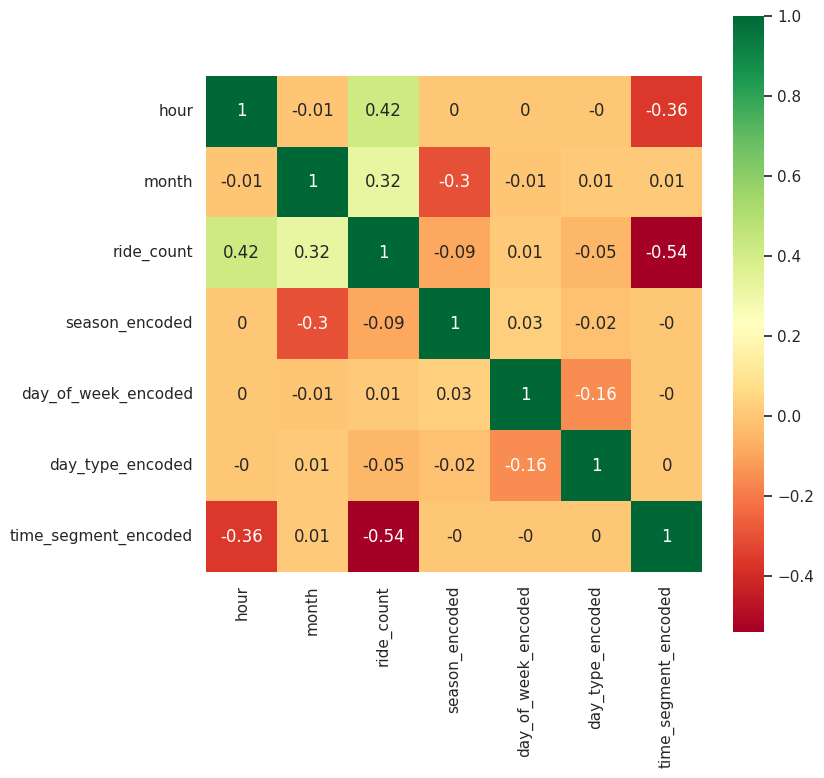

In [155]:
import seaborn as sns
sns.set(rc={'figure.figsize':(8,8)})
sns.heatmap(transformed_df.corr().round(2), square=True, cmap='RdYlGn', annot=True)

In [156]:
X = transformed_df.drop(['ride_count'], axis=1)  # Features
y = transformed_df['ride_count']  # Target (ride_count)

In [157]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [158]:
# Create a StandardScaler instance for the features
scaler_X = StandardScaler()

#Fit the scaler on the training data and transform both the training and test sets
X_train_scaled = scaler_X.fit_transform(X_train)
X_test_scaled = scaler_X.transform(X_test)

#Create another StandardScaler instance for the target variable
scaler_y = StandardScaler()

# Fit the scaler on the training target and transform both training and test target variables
y_train_scaled = scaler_y.fit_transform(y_train.values.reshape(-1, 1))
y_test_scaled = scaler_y.transform(y_test.values.reshape(-1, 1))

In [92]:
X_train_scaled

array([[ 0.0701247 , -0.19077964, -1.31146487,  1.50445183, -0.63299958,
        -1.56488712],
       [-0.64860935, -0.19077964, -1.31146487,  1.00517653, -0.63299958,
         0.21424831],
       [-1.07984978, -1.42102109,  1.34740437, -0.99192469, -0.63299958,
         1.10381602],
       ...,
       [ 1.22009919,  0.62938133,  0.01796975,  0.00662592,  1.57977988,
        -0.67531941],
       [-0.93610297,  1.03946181,  0.01796975, -0.99192469, -0.63299958,
         0.21424831],
       [-0.50486254, -1.01094061,  1.34740437,  1.00517653, -0.63299958,
         0.21424831]])

In [159]:
import warnings
warnings.filterwarnings('ignore')

# Suppress output in scikit-learn
from sklearn.utils._testing import ignore_warnings
from sklearn.exceptions import ConvergenceWarning

In [160]:
import numpy as np
import pandas as pd
import time
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score, explained_variance_score
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import Ridge, Lasso, ElasticNet
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
import xgboost as xgb
import warnings

warnings.filterwarnings('ignore')


# Function to apply all algorithms and collect their metrics
def evaluate_models(X_train, X_test, y_train, y_test):

    results = {
        'Algorithm': [],
        'Train RMSE': [],
        'Train R²': [],
        'Train MAE': [],
        'Test RMSE': [],
        'Test R²': [],
        'Test MAE': [],
        'Training Time (s)': []
    }

    models = [
        ('Ridge', Ridge(), {'alpha': [0.01, 0.1, 1.0, 10.0, 50.0, 100.0]}),
        ('Lasso', Lasso(), {'alpha': [0.01, 0.1, 1.0, 10.0, 50.0, 100.0]}),
        ('ElasticNet', ElasticNet(), {'alpha': [0.01, 0.1, 1.0, 10.0], 'l1_ratio': [0.1, 0.5, 0.7, 1.0]}),
        ('RandomForest', RandomForestRegressor(verbose=0), {'n_estimators': [100, 200, 300], 'max_depth': [None, 10, 20], 'min_samples_split': [2, 5, 10]}),
        ('GradientBoosting', GradientBoostingRegressor(), {'n_estimators': [100, 200, 300], 'learning_rate': [0.01, 0.1, 0.2], 'max_depth': [3, 5, 7]}),
        ('XGBoost', xgb.XGBRegressor(verbosity=0), {'n_estimators': [100, 200, 300], 'learning_rate': [0.01, 0.1, 0.2], 'max_depth': [3, 5, 7]})
    ]


    for name, model, param_grid in models:
        print(f"Training {name}...")

        # Start timer
        start_time = time.time()

        # GridSearchCV for hyperparameter tuning
        grid_search = GridSearchCV(model, param_grid, cv=5, scoring='neg_mean_squared_error')
        grid_search.fit(X_train, y_train)

        # End timer
        end_time = time.time()
        training_time = end_time - start_time

        # Get the best model from grid search
        best_model = grid_search.best_estimator_

        # Make predictions on the training and test sets
        y_train_pred = best_model.predict(X_train)
        y_test_pred = best_model.predict(X_test)

        # Calculate metrics for training data
        train_rmse = mean_squared_error(y_train, y_train_pred, squared=False)
        train_r2 = r2_score(y_train, y_train_pred)
        train_mae = mean_absolute_error(y_train, y_train_pred)

        # Calculate metrics for testing data
        test_rmse = mean_squared_error(y_test, y_test_pred, squared=False)
        test_r2 = r2_score(y_test, y_test_pred)
        test_mae = mean_absolute_error(y_test, y_test_pred)

        # Store results
        results['Algorithm'].append(name)
        results['Train RMSE'].append(train_rmse)
        results['Train R²'].append(train_r2)
        results['Train MAE'].append(train_mae)
        results['Test RMSE'].append(test_rmse)
        results['Test R²'].append(test_r2)
        results['Test MAE'].append(test_mae)
        results['Training Time (s)'].append(training_time)

        # Print completion time and metrics
        print(f"Training completed for {name} in {training_time:.2f} seconds.")
        print(f"Training Metrics - RMSE: {train_rmse:.4f}, R²: {train_r2:.4f}, MAE: {train_mae:.4f}")
        print(f"Testing Metrics  - RMSE: {test_rmse:.4f}, R²: {test_r2:.4f}, MAE: {test_mae:.4f}")
        print("-" * 50)

    # Create a DataFrame from the results
    results_df = pd.DataFrame(results)

    # Find the best model based on Test RMSE
    best_model_idx = results_df['Test RMSE'].idxmin()
    best_model_name = results_df.iloc[best_model_idx]['Algorithm']

    print(f"Best Model: {best_model_name}")

    return results_df, best_model_name, best_model

results_df, best_model_name, model = evaluate_models(X_train_scaled, X_test_scaled, y_train_scaled, y_test_scaled)
display(results_df)
print(f"The best model is: {best_model}")


Training Ridge...
Training completed for Ridge in 0.10 seconds.
Training Metrics - RMSE: 0.7319, R²: 0.4643, MAE: 0.5444
Testing Metrics  - RMSE: 0.7646, R²: 0.4380, MAE: 0.5710
--------------------------------------------------
Training Lasso...
Training completed for Lasso in 0.09 seconds.
Training Metrics - RMSE: 0.7323, R²: 0.4637, MAE: 0.5441
Testing Metrics  - RMSE: 0.7635, R²: 0.4396, MAE: 0.5688
--------------------------------------------------
Training ElasticNet...
Training completed for ElasticNet in 0.22 seconds.
Training Metrics - RMSE: 0.7320, R²: 0.4642, MAE: 0.5443
Testing Metrics  - RMSE: 0.7643, R²: 0.4383, MAE: 0.5704
--------------------------------------------------
Training RandomForest...
Training completed for RandomForest in 135.83 seconds.
Training Metrics - RMSE: 0.3296, R²: 0.8914, MAE: 0.2050
Testing Metrics  - RMSE: 0.3818, R²: 0.8598, MAE: 0.2455
--------------------------------------------------
Training GradientBoosting...
Training completed for Gradie

,Algorithm,Train RMSE,Train R²,Train MAE,Test RMSE,Test R²,Test MAE,Training Time (s)
0,Ridge,0.731936,0.464270,0.544393,0.764556,0.437996,0.570968,0.095118
1,Lasso,0.732339,0.463680,0.544128,0.763486,0.439568,0.568792,0.093959
2,ElasticNet,0.731970,0.464220,0.544252,0.764332,0.438325,0.570426,0.219262
3,RandomForest,0.329573,0.891382,0.205043,0.381812,0.859842,0.245499,135.831534
4,GradientBoosting,0.345676,0.880508,0.219953,0.377586,0.862927,0.244289,84.114760
5,XGBoost,0.339084,0.885022,0.211853,0.374902,0.864869,0.240504,19.247043


The best model is: XGBoost


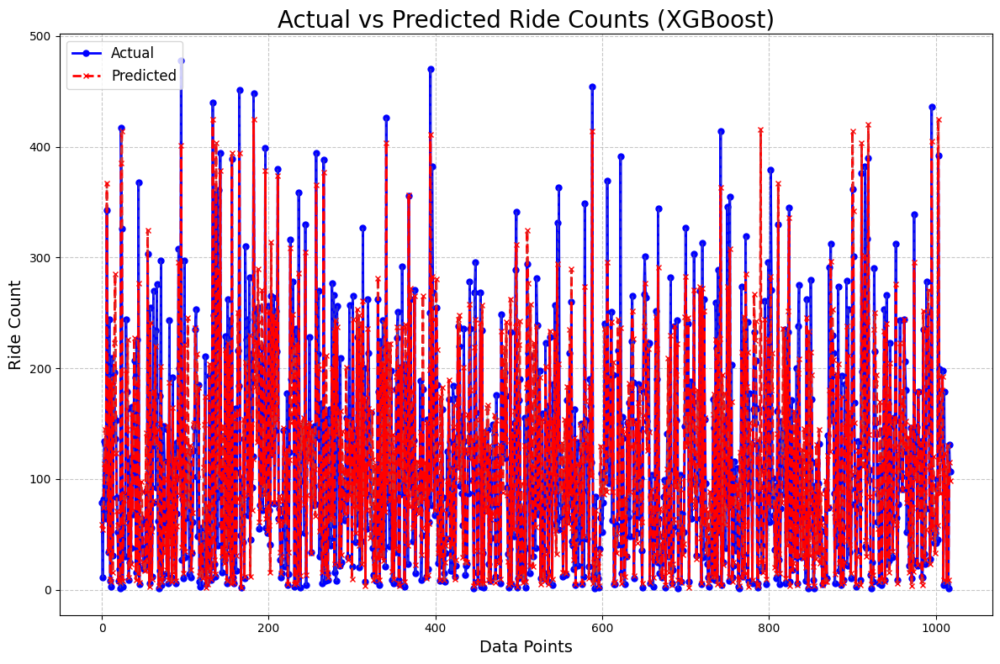

In [175]:
import matplotlib.pyplot as plt
import numpy as np

def plot_actual_vs_predicted(y_true, y_pred, model_name, rmse=None, r2=None):

    plt.figure(figsize=(12, 8))
    plt.plot(range(len(y_true)), y_true, color='blue', label='Actual', linewidth=2, marker='o', markersize=5)
    plt.plot(range(len(y_pred)), y_pred, color='red', label='Predicted', linestyle='--', linewidth=2, marker='x', markersize=5)

    for i in range(len(y_true)):
        plt.plot([i, i], [y_true[i], y_pred[i]], color='gray', alpha=0.3, linestyle='--')

    plt.title(f"Actual vs Predicted Ride Counts ({model_name})", fontsize=20)
    plt.xlabel("Data Points", fontsize=14)
    plt.ylabel("Ride Count", fontsize=14)

    plt.grid(True, linestyle='--', alpha=0.7)

    plt.legend(loc='upper left', fontsize=12)
    plt.tight_layout()
    plt.show()

y_pred_best = model.predict(X_test_scaled)
y_test_original = scaler_y.inverse_transform(y_test_scaled.reshape(-1, 1))
y_pred_best_original = scaler_y.inverse_transform(y_pred_best.reshape(-1, 1))
plot_actual_vs_predicted(y_test_original.flatten(), y_pred_best_original.flatten(), best_model_name)


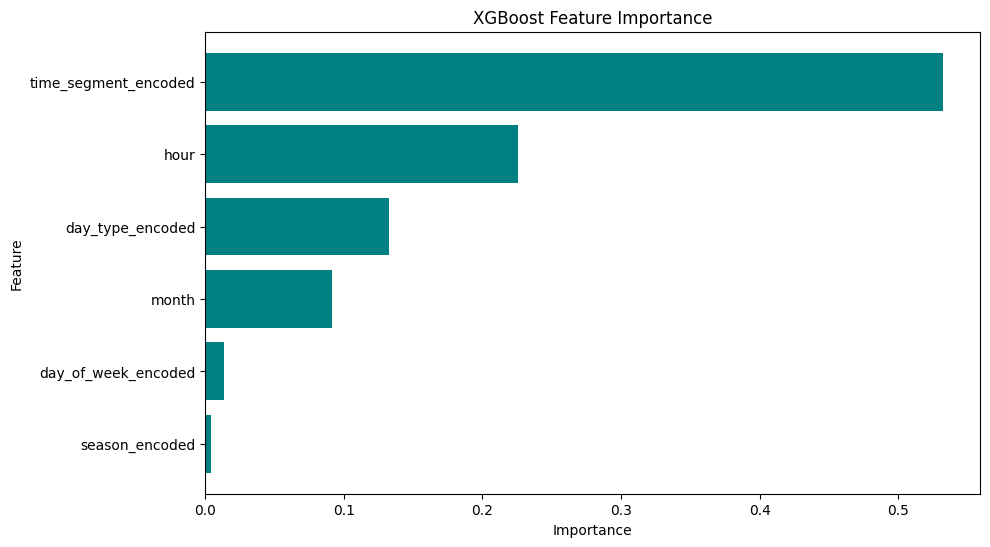

,Feature,Importance
5,time_segment_encoded,0.532174
0,hour,0.225450
4,day_type_encoded,0.132463
1,month,0.091806
3,day_of_week_encoded,0.013760
2,season_encoded,0.004348


In [176]:
import matplotlib.pyplot as plt
import xgboost as xgb

if isinstance(model, xgb.XGBRegressor):
    # Get the feature importance scores
    feature_importances = model.feature_importances_

    # Get feature names from the original dataset
    feature_names = X_train.columns

    # Create a DataFrame for better visualization
    feature_importance_df = pd.DataFrame({
        'Feature': feature_names,
        'Importance': feature_importances
    }).sort_values(by='Importance', ascending=False)

    # Plot the feature importance
    plt.figure(figsize=(10, 6))
    plt.barh(feature_importance_df['Feature'], feature_importance_df['Importance'], color='teal')
    plt.xlabel('Importance')
    plt.ylabel('Feature')
    plt.title('XGBoost Feature Importance')
    plt.gca().invert_yaxis()
    plt.show()

    display(feature_importance_df)
else:
    print("The best model is not XGBoost. Feature importance cannot be calculated.")


In [180]:
pip install shap

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 540.1/540.1 kB 9.0 MB/s eta 0:00:00


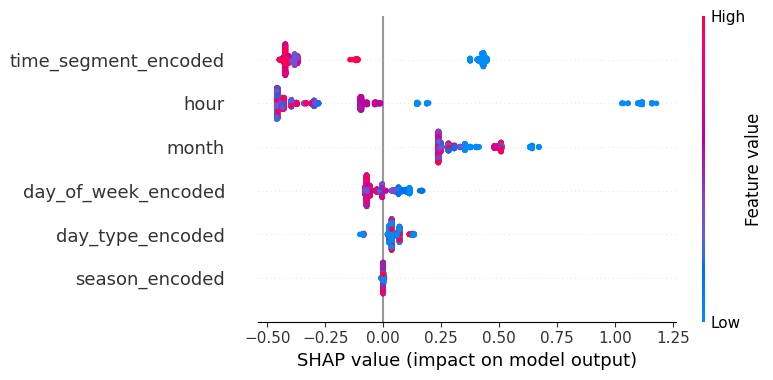

In [181]:
import shap

explainer = shap.TreeExplainer(model)
shap_values = explainer.shap_values(X_test)

# Plot SHAP summary plot for overall feature importance
shap.summary_plot(shap_values, X_test, feature_names=X_test.columns)


In [184]:
shap.initjs()
shap.force_plot(explainer.expected_value, shap_values[0], X_test.iloc[30])
